# Notes about simulation:

**Running info**
- 2250 simulations
- week queue

**EA params**
- 160 generations
- 250 individuals
- 0.1 mutation rate
- 0.5 crossover rate

**Parameter search space**
- beta_0,    k1, k3, k5, k7,    k2, k4, k6, k8,    kn, kc,    K_1, K_3, K_5, K_7,    K_2, K_4, K_6, K_8
- minimums = [ -4,   -2, -2, -2, -2,   -2, -2, -2, -2,   -2, -2,     -2, -2, -2, -2,    -2, -2, -2, -2]
- maximums = [4.5,    4,  4,  4,  4,    4,  4,  4,  4,    4,  4,     4,   4,  4,  4,     4,  4,  4,  4]

**Mean of Mean Square Error of the top 2.5% of Individuals** 
- 1404.57196018


# Import packages and set settings

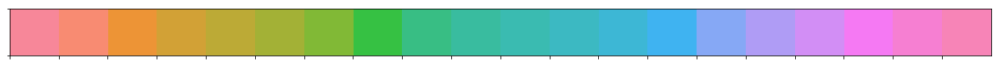

In [1]:
%matplotlib inline
import pathlib
import seaborn as sns
import matplotlib.pyplot as plt
import pickle
import numpy as np
import math
import pandas as pd
from scipy.integrate import odeint
import os

# plt.style.use("seaborn-whitegrid")
plt.rcParams['figure.figsize'] = [10.0, 8.0]
plt.rcParams['axes.titlesize'] = 20
plt.rcParams['axes.labelsize'] = 18
plt.rcParams['xtick.labelsize'] = 14
plt.rcParams['ytick.labelsize'] = 14
plt.rcParams['grid.linestyle'] = '-'
plt.rcParams['legend.fontsize'] = 14
colors = [i['color'] for i in plt.rcParams['axes.prop_cycle']]

sns.palplot(sns.husl_palette(20, l=.7))
palette_husl = sns.husl_palette(20, l=.7)
# palette_husl.as_hex()

# Load data to fit to

In [5]:
wt_folder = '../data/MAPK activation/WT'
t100a_folder = '../data/MAPK activation/T100A'

def load_csv_data(folder):
    data = []
    for csv in pathlib.Path(folder).glob('*.csv'):
        f_data = pd.read_csv(csv)
        time = f_data['Time'].tolist()
        f_data=f_data.set_index('Time')
        f_data = f_data.mean(axis=1)
        f_data = f_data.tolist()
        data.append(f_data)
    return time, data

mapk_time, mapk_wt_data = load_csv_data(wt_folder)
mapk_time, mapk_t100a_data = load_csv_data(t100a_folder)

scorefxn_data = [mapk_wt_data, mapk_t100a_data]

# Supporting Functions

In [6]:
# def scorefxn1(scorefxn_time, scorefxn_data, inits, params_constants,
#               learned_params, time, plot_bool):
#     mse_total = 0
#     arr_params_IP = convert_individual(learned_params, arr_conversion_matrix)

#     for sig, MAPK_wt_data, MAPK_t100a_data in zip(params_constants[-1], scorefxn_data[0], scorefxn_data[1]):
#         params_constants = params_constants[:-1]+[sig]

#         # WT simulation
#         data = simulate_wt_experiment(inits, params_constants, arr_params_IP, time)
#         active = (data[:,2] + data[:,3])/params_constants[2]*100
#         # get index of time points closest
#         idx_closest_time_points = []
#         for each_time in scorefxn_time:
#             closest_idx = min(range(len(time)),
#                               key = lambda i: abs(time[i] - each_time))
#             idx_closest_time_points.append(closest_idx)
#         # use indexes of time points to get data points to score against
#         _scorefxn_data_active = active[[idx_closest_time_points]]
#         error_active = ((MAPK_wt_data - _scorefxn_data_active)**2).mean()
#         mse_total += error_active

#         # T100A simulation
#         data = simulate_t100a_experiment(inits, params_constants, arr_params_IP, time)
#         active = (data[:,2] + data[:,3])/params_constants[2]*100
#         idx_closest_time_points = []
#         for each_time in scorefxn_time:
#             closest_idx = min(range(len(time)),
#                               key = lambda i: abs(time[i] - each_time))
#             idx_closest_time_points.append(closest_idx)
#         _scorefxn_data_active = active[[idx_closest_time_points]]
#         error_active = ((MAPK_t100a_data - _scorefxn_data_active)**2).mean()
#         mse_total += error_active
#     return mse_total


# def scorefxn_helper(individual):
#     # just a helper function that pulls all of scorefxn1 dependencies together
#     # note the (), <--using single optimization in DEAP for now
#     # scorefxn1 is taking care of the multiple optimizations for now
#     return scorefxn1(mapk_time, scorefxn_data, inits, params_constants, individual, time, False),

def molarity_conversion(molecules):
    Na = 6.02214076*10**23
    cell_volume = 44                                  # volume of a yeast cell
    return molecules/(Na*cell_volume*10**-15)*100000 # returns uM

# Two step delay - a1 uM

## Functions

In [15]:
def b0_a1_2D_Y(initals,t,params_constants,params):
    MAP3K, MAP2K, MAPK, X, Y = initals
    MAP3K_t, MAP2K_t, MAPK_t, X_t, Y_t, s = params_constants
    beta_0, alpha_1, k1, k3, k5, k7, k9, k2, k4, k6, k8, k10, K_1, K_3, K_5, K_7, K_9, K_2, K_4, K_6, K_8, K_10 = params

    MAP3K_I = MAP3K_t-MAP3K
    MAP2K_I = MAP2K_t-MAP2K
    MAPK_I = MAPK_t-MAPK
    X_I = X_t-X
    Y_I = Y_t-Y

    dMAP3K = (s/(1+Y/beta_0)) * ((k1*MAP3K_I)/(K_1+MAP3K_I)) - (k2*MAP3K/(K_2+MAP3K))
    dMAP2K = (((k3*MAP3K)*MAP2K_I)/(K_3+MAP2K_I)) - (k4*MAP2K/(K_4+MAP2K))
    dMAPK = (((k5*MAP2K+alpha_1*MAPK)*MAPK_I)/(K_5+MAPK_I)) - (k6*MAPK/(K_6+MAPK))
    dX = ((k7*MAPK*X_I) / (K_7+X_I)) - (k8*X/(K_8+X))
    dY = ((k9*X*Y_I) / (K_9+X_I)) - (k10*Y/(K_10+Y))

    return dMAP3K, dMAP2K, dMAPK, dX, dY


def simulate_wt_experiment_a1_2D_Y(inits, params_constants, learned_params, time):
    # parameters to be learned - inits
    # parameters to be kept constant - params_constants
    # parameters to be learned - learned_params

    #solve odes:
    odes = odeint(b0_a1_2D_Y, inits, time, args=(params_constants, learned_params))

    return odes

def simulate_t100a_experiment_a1_2D_Y(inits, params_constants, learned_params, time):
    # parameters to be learned - inits
    # parameters to be kept constant - params_constants
    # parameters to be learned - learned_params
    beta_0, alpha_1, k1, k3, k5, k7, k9, k2, k4, k6, k8, k10, K_1, K_3, K_5, K_7, K_9, K_2, K_4, K_6, K_8, K_10  = learned_params
    learned_params = beta_0, 0, k1, k3, k5, 0, k9, k2, k4, k6, k8, k10, K_1, K_3, K_5, K_7, K_9, K_2, K_4, K_6, K_8, K_10
    #solve odes:
    odes = odeint(b0_a1_2D_Y, inits, time, args=(params_constants, learned_params))
    
    return odes


## Input

In [16]:
folder = 'C:/Users/sksuzuki/Desktop/killdevil/from/180917_b0_a1_2D_k7_Y_uM' #change molarity conversion!
mins = [-4, -4,
        -4, -4, -4, -4, -4,
        -4, -4, -4, -4, -4,
        -4, -4, -4, -4, -4,
        -4, -4, -4, -4, -4]
maxs = [4, 4,
        4, 4, 4, 4, 4,
        4, 4, 4, 4, 4,
        4, 4, 4, 4, 4,
        4, 4, 4, 4, 4]
X_t = 100
Y_t = 100


# folder = 'C:/Users/sksuzuki/Desktop/killdevil/from/180928_b0_a1_2D_k7_Y_uM'
# mins = [-8, -8,
#         -5, -5, -5, -5, -4,
#         -6, -6, -6, -6, -4,
#         -4, -4, -4, -4, -4,
#         -4, -4, -4, -4, -4]
# maxs = [4, 8,
#         4, 1, 1, 1, 4,
#         4, 0, 0, 0, 4,
#         4, 4, 4, 4, 4,
#         4, 4, 4, 4, 4]
# X_t = 1
# Y_t = 1

gen = 500
runs = 2000

MAP3K = 0
MAP2K = 0
MAPK = 0
X = 0
Y = 0

# Protein concentrations (uM)
MAP3K_t = molarity_conversion(1170)
MAP2K_t = molarity_conversion(2282)
MAPK_t = molarity_conversion(5984)

s = [0, 150000, 250000, 350000, 450000, 550000]


labelnames = ['B0', 'A1',
              'k1', 'k3', 'k5', 'k7', 'k9',
              'k2', 'k4', 'k6', 'k8', 'k10',
              'K1', 'K3', 'K5', 'K7', 'K9',
              'K2', 'K4', 'K6', 'K8', 'K10']


diff = np.asarray(maxs)-np.asarray(mins)

# fb = 1
# t100a_fb = 0

initals = [MAP3K, MAP2K, MAPK, X, Y]
params_constants = [MAP3K_t, MAP2K_t, MAPK_t, X_t, Y_t, s]
    
dt = 0.1
steps = 600
time = np.linspace(0,dt*steps,steps)

## Gather simulated data

In [17]:
mse = []
params_from_file = []

empty_data = 0
for loaded_data in pathlib.Path(folder).glob('*.pickled'):
    if os.path.getsize(loaded_data) > 0:
        with open(loaded_data, 'rb') as f:
            new_data = pickle.load(f)
            mse.append(np.asarray(new_data[0]))
            params_from_file.append(np.asarray(new_data[1]))
    else:
        empty_data += 1

top = round((runs-empty_data)*0.05)
plt_top = round((runs-empty_data)*0.01)      
    
new_params = []
last_mses = []
for i in range(len(params_from_file)):
    new_params.append(params_from_file[i][gen])
    last_mses.append(mse[i][gen])
last_mses = np.asarray(last_mses)
new_params = np.asarray(new_params)
new_params = new_params.T

idx_top = last_mses.argsort()[:top]

top_params_a1 = [([new_params[i][x] for i in range(len(new_params))]) for x in idx_top]
# top_params = []
# for idx in idx_top:
#     top_params.append(params_from_file[idx][100])

print('Best MSE: ' + str(np.min([mse[idx][gen] for idx in idx_top])))

Best MSE: 966.560933652


In [18]:
df_top_params = pd.DataFrame(top_params_a1)
df_top_params.columns = labelnames
df_top_params_log = df_top_params.apply(np.log10)
df_top_params_log_M = df_top_params_log.melt(var_name='param', value_name='vals')

## Plot 

# of unstable WT experiments: 0 of 120
# of unstable T100A experiments: 0 of 120


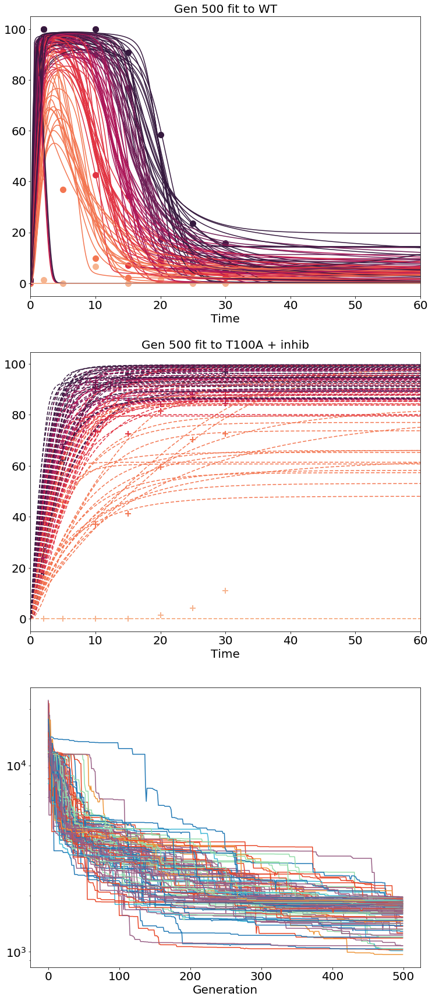

In [79]:
#initialize figure:
plt.clf()
fig, (ax1,ax2,ax3) = plt.subplots(3, 1, figsize=(12,30))


#plot 1
title_text = 'Gen ' + str(gen) + ' fit to WT'
ax1.set_title(title_text, fontsize=20)
ax1.set_xlabel('Time', fontsize=20)
# ax1.set_ylabel('gene expression', fontsize=20)
# ax1.set_xlim([0,150])1
# ax1.set_ylim([0,15])
plt.rc('xtick', labelsize=20) 
plt.rc('ytick', labelsize=20)
color_palette = sns.color_palette("rocket", 6)[::-1]

# plot real data:
for idx, wt_data in enumerate(mapk_wt_data):
    ax1.plot(mapk_time, wt_data, 'o', markersize=10, color=color_palette[idx])
#     ax1.plot(mapk_time, t100a_data, '+', mew=2, markersize=10, color=color_palette[idx])

# plot evolutionary algorithm data:
unstable = 0
for idx in idx_top[:plt_top]:
    learned_params = params_from_file[idx][gen]
    for idx, sig in enumerate(params_constants[-1]):
        params_c = params_constants[:-1]+[sig]
        data = simulate_wt_experiment_a1_2D_Y(initals, params_c, learned_params, time)
        active = data[:,2]/params_constants[2]*100
        if len([*filter(lambda x: x <= 100, active)]) == len(active) and len([*filter(lambda x: x >= 0, active)]) == len(active):
            ax1.plot(time, active, color=color_palette[idx])
        else:
            unstable += 1
# ax1.set_ylim(0, 100)
ax1.set_xlim(0,60)
print('# of unstable WT experiments: ' + str(unstable) + ' of ' + str(plt_top*6))
# ax1.legend(bbox_to_anchor=[1, 0.5], loc='center left')

#plot 2
title_text = 'Gen ' + str(gen) +  ' fit to T100A + inhib'
ax2.set_title(title_text, fontsize=20)
ax2.set_xlabel('Time', fontsize=20)

for idx, t100a_data in enumerate(mapk_t100a_data):
    ax2.plot(mapk_time, t100a_data, '+', mew=2, markersize=10, color=color_palette[idx])
    
# plot evolutionary algorithm data:
unstable = 0
for idx in idx_top[:plt_top]:
    learned_params = params_from_file[idx][gen]
    for idx, sig in enumerate(params_constants[-1]):
        params_c = params_constants[:-1]+[sig]
#         print(params_c)
        data = simulate_t100a_experiment_a1_2D_Y(initals, params_c, learned_params, time)
        active = data[:,2]/params_constants[2]*100
        if len([*filter(lambda x: x <= 100, active)]) == len(active) and len([*filter(lambda x: x >= 0, active)]) == len(active):
            ax2.plot(time, active, dashes= [4,2], color=color_palette[idx], label = 'ppMAPK at '  + str(sig))
        else:
            unstable += 1
# ax1.set_ylim(0, 100)
ax2.set_xlim(0,60)
print('# of unstable T100A experiments: ' + str(unstable) + ' of ' + str(plt_top*6))
# ax2.legend(bbox_to_anchor=[1, 0.5], loc='center left')
#plot2    
ax3.set_xlabel('Generation', fontsize=20)
# ax2.set_ylabel('Sum of MSE', fontsize=20)
# ax3.set_yscale('log')
# ax2.set_xlim([0,gen])
# ax2.set_ylim([10**3,10**5])
for idx in idx_top:
    ax3.semilogy([x for x in range(gen)], mse[idx][:gen])
    

plt.show()

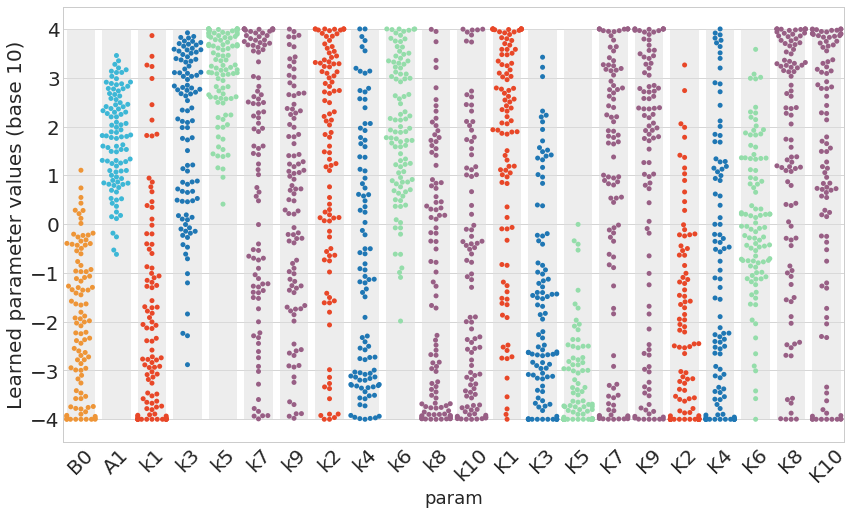

In [80]:
plt.rcParams['figure.figsize'] = [14.0, 8.0]

# positive 3db7d6
# negative ee9537
# hog1 ? 38bf85 or 94ddaa

colors = ['#ee9537', '#3db7d6',
          '#e84728','#1f77b4','#94ddaa','#985f85', '#985f85',
          '#e84728','#1f77b4','#94ddaa','#985f85', '#985f85',
          '#e84728', '#1f77b4','#94ddaa','#985f85', '#985f85',
          '#e84728','#1f77b4','#94ddaa','#985f85', '#985f85']

pal = sns.set_palette(colors)

with sns.axes_style("whitegrid"):
    plt.bar(range(0,len(labelnames)),height=diff,bottom=mins,align='center',tick_label=labelnames, color='#DCDCDC',alpha = 0.5)
    x = sns.swarmplot(x='param',y='vals', data = df_top_params_log_M)
    x.set_xticklabels(labelnames,rotation=45)
#     plt.xlabel('Parameters', fontsize=20)
    plt.ylabel('Learned parameter values (base 10)', fontsize=20)
#     ax.yaxis.set_major_locator(ticker.MultipleLocator(2))

In [89]:
print(top_params_a1[0])
print(top_params_a1[1])

[0.0040953559478501675, 196.229992503608, 0.086557126450097513, 240.63110303897534, 4754.5096955018498, 0.031275586662352986, 2122.7317169811299, 9998.0266652734317, 0.07429369662541814, 85.092668531633436, 0.0041876991693350933, 8610.7518999891017, 0.0002888157753392328, 50.772416176836686, 0.00010102490867424722, 59.606143077705141, 1568.3320209564624, 0.00010000000164331376, 0.50712428712329349, 0.33931173916744622, 2285.3435177397801, 417.76825586973126]
[0.0036193496540292986, 668.54837453402308, 0.00010004116737404634, 3711.4893791351392, 2881.057378170688, 200.25980962175402, 10.934850591824185, 181.75610245538414, 44.541440456983601, 135.79277013754657, 5.4034090546103357, 0.00011074113008057884, 5005.9399456336005, 0.38775289281602626, 0.00010000760248384563, 0.01875236574531557, 7688.3201065607045, 96.255231383655016, 515.60290966008426, 0.17565967660354381, 9539.4193284680841, 0.00011900301121425564]


# of unstable WT experiments: 0 of 120
# of unstable T100A experiments: 0 of 120


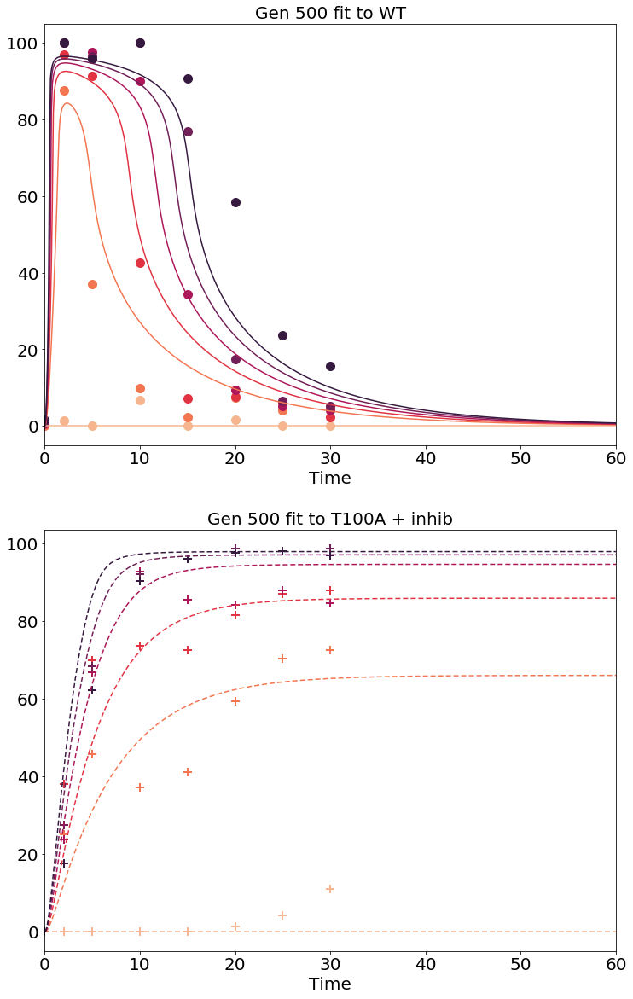

In [87]:
temp=[1]
#initialize figure:
plt.clf()
fig, (ax1,ax2) = plt.subplots(2, 1, figsize=(12,20))


#plot 1
title_text = 'Gen ' + str(gen) + ' fit to WT'
ax1.set_title(title_text, fontsize=20)
ax1.set_xlabel('Time', fontsize=20)
# ax1.set_ylabel('gene expression', fontsize=20)
# ax1.set_xlim([0,150])1
# ax1.set_ylim([0,15])
plt.rc('xtick', labelsize=20) 
plt.rc('ytick', labelsize=20)
color_palette = sns.color_palette("rocket", 6)[::-1]

# plot real data:
for idx, wt_data in enumerate(mapk_wt_data):
    ax1.plot(mapk_time, wt_data, 'o', markersize=10, color=color_palette[idx])
#     ax1.plot(mapk_time, t100a_data, '+', mew=2, markersize=10, color=color_palette[idx])

# plot evolutionary algorithm data:
unstable = 0
for idx in idx_top[temp]:
    learned_params = params_from_file[idx][gen]
    for idx, sig in enumerate(params_constants[-1]):
        params_c = params_constants[:-1]+[sig]
        data = simulate_wt_experiment_a1_2D_Y(initals, params_c, learned_params, time)
        active = data[:,2]/params_constants[2]*100
        if len([*filter(lambda x: x <= 100, active)]) == len(active) and len([*filter(lambda x: x >= 0, active)]) == len(active):
            ax1.plot(time, active, color=color_palette[idx])
        else:
            unstable += 1
# ax1.set_ylim(0, 100)
ax1.set_xlim(0,60)
print('# of unstable WT experiments: ' + str(unstable) + ' of ' + str(plt_top*6))
# ax1.legend(bbox_to_anchor=[1, 0.5], loc='center left')

#plot 2
title_text = 'Gen ' + str(gen) +  ' fit to T100A + inhib'
ax2.set_title(title_text, fontsize=20)
ax2.set_xlabel('Time', fontsize=20)

for idx, t100a_data in enumerate(mapk_t100a_data):
    ax2.plot(mapk_time, t100a_data, '+', mew=2, markersize=10, color=color_palette[idx])
    
# plot evolutionary algorithm data:
unstable = 0
for idx in idx_top[temp]:
    learned_params = params_from_file[idx][gen]
    for idx, sig in enumerate(params_constants[-1]):
        params_c = params_constants[:-1]+[sig]
#         print(params_c)
        data = simulate_t100a_experiment_a1_2D_Y(initals, params_c, learned_params, time)
        active = data[:,2]/params_constants[2]*100
        if len([*filter(lambda x: x <= 100, active)]) == len(active) and len([*filter(lambda x: x >= 0, active)]) == len(active):
            ax2.plot(time, active, dashes= [4,2], color=color_palette[idx], label = 'ppMAPK at '  + str(sig))
        else:
            unstable += 1
# ax1.set_ylim(0, 100)
ax2.set_xlim(0,60)
print('# of unstable T100A experiments: ' + str(unstable) + ' of ' + str(plt_top*6))
# ax2.legend(bbox_to_anchor=[1, 0.5], loc='center left')

    

plt.show()

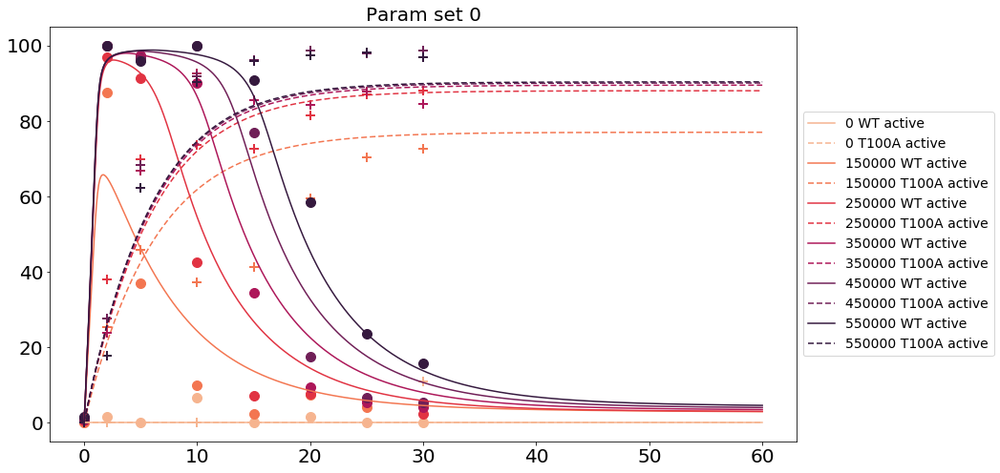

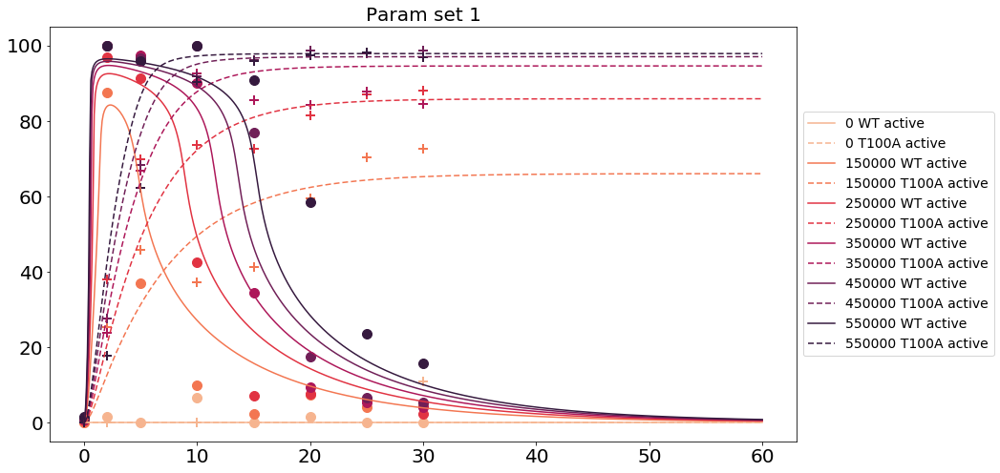

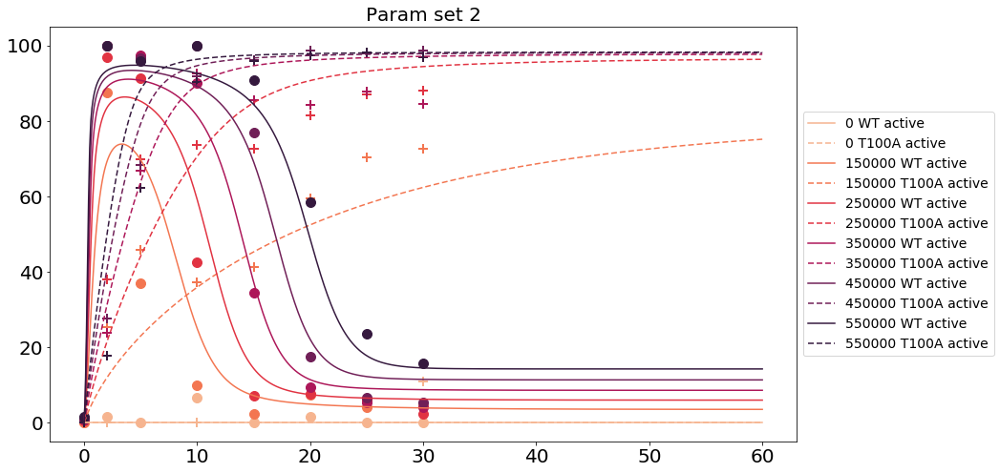

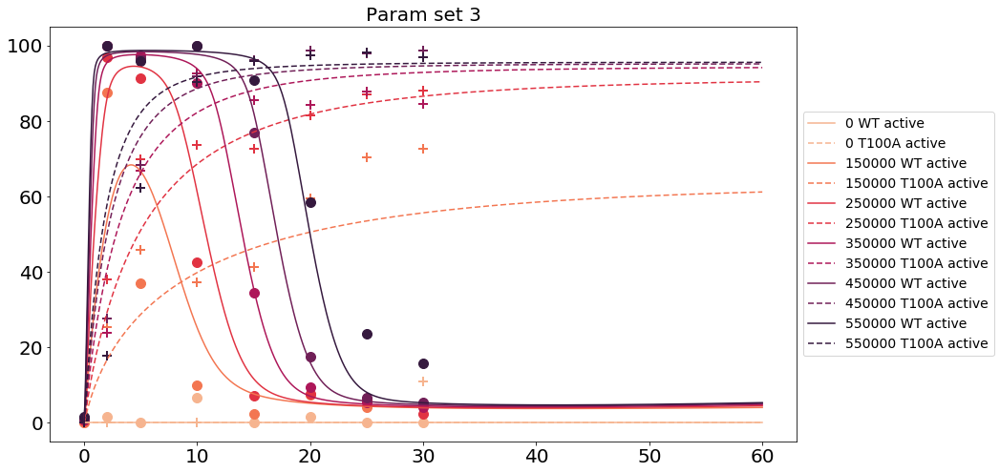

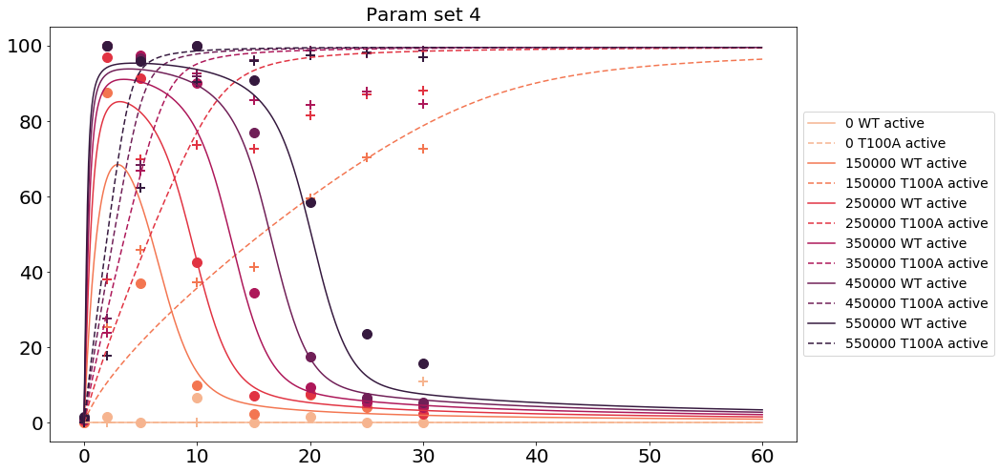

...

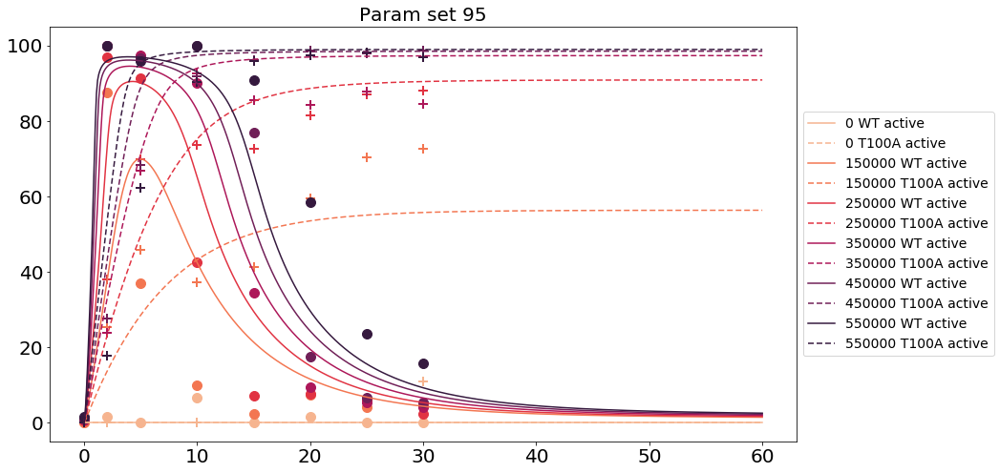

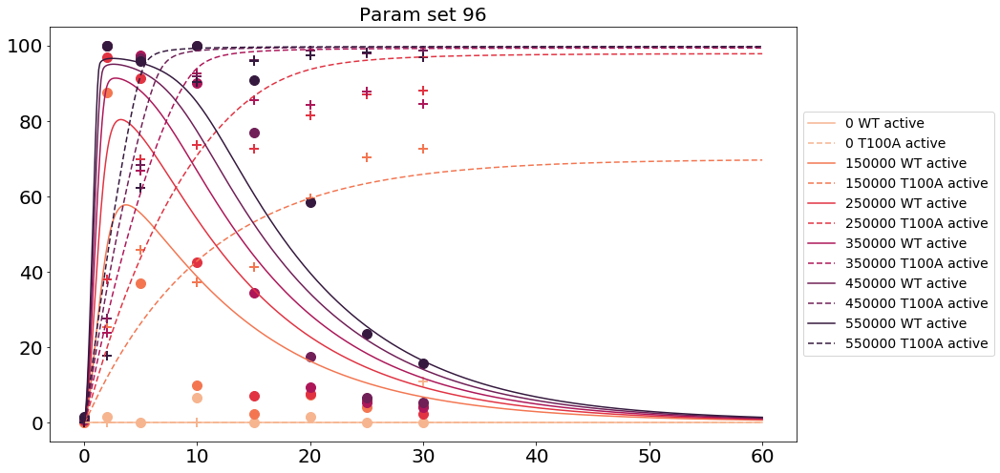

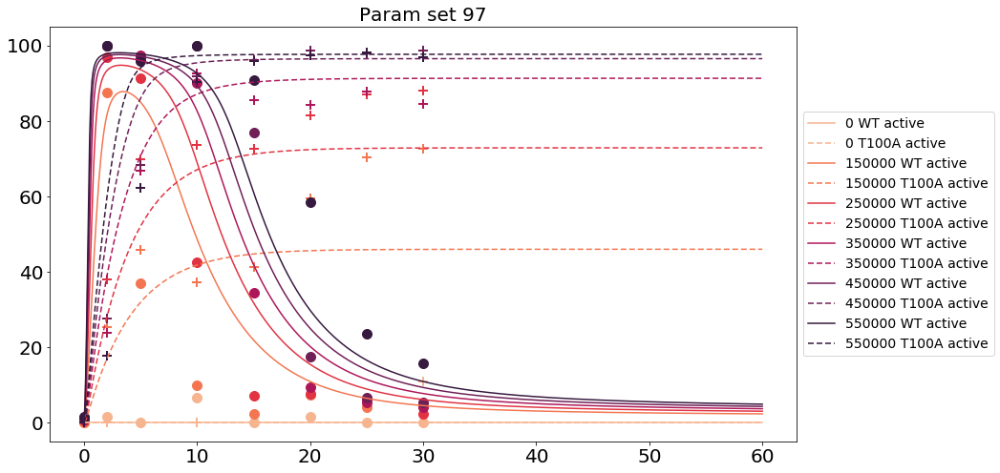

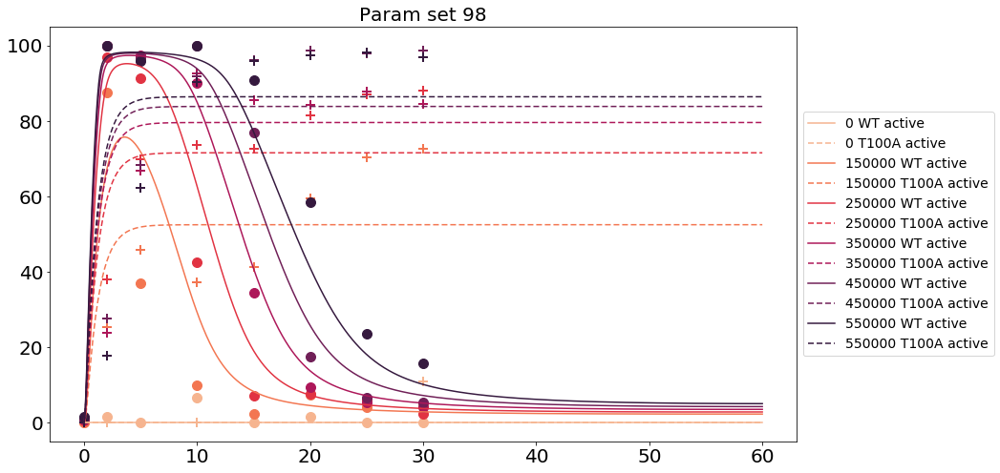

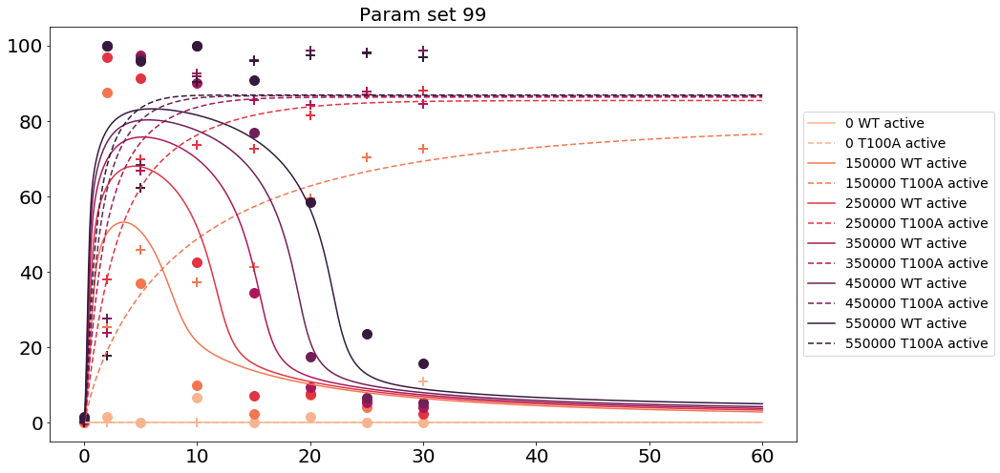

In [95]:
color_palette = sns.color_palette("rocket", 6)[::-1]

for i, params in enumerate(top_params_a1):
#     beta_1, beta_2, alpha, k1, k2, k3, k4, k5, k6, k7, k8, K_1, K_2, K_3, K_4, K_5, K_6, K_7, K_8, kn, kc = params
#     params = beta_1, beta_2, 0, k1, k2, k3, k4, k5, k6, k7, k8, K_1, K_2, K_3, K_4, K_5, K_6, K_7, K_8, 0, kc
    #plot real data:
    for idx, (wt_data,t100a_data) in enumerate(zip(mapk_wt_data, mapk_t100a_data)):
        plt.plot(mapk_time, wt_data, 'o', markersize=10, color=color_palette[idx])
        plt.plot(mapk_time, t100a_data, '+', mew=2, markersize=10, color=color_palette[idx])
    for idx, signal in enumerate(s):
        data = odeint(b0_a1_2D_Y, initals, time, args=(params_constants[:-1]+[signal], params))
#         data = simulate_wt_experiment_a1_2D_Y(initals, params_constants[:-1]+[signal], params, time)
        active = data[:,2]/params_constants[2]*100
        plt.plot(time, active, label=str(signal)+' WT active', color=color_palette[idx])
#         plt.plot(time, data[:,4], dashes=[2, 2], label=str(signal)+' X')
        data = simulate_t100a_experiment_a1_2D_Y(initals, params_constants[:-1]+[signal], params, time)
        active = data[:,2]/params_constants[2]*100
        plt.plot(time, active, label=str(signal)+' T100A active', dashes= [4,2], color=color_palette[idx])
#         plt.plot(time, data[:,3], label=str(signal)+' MAPKn')
    plt.title(f'Param set {i}')
    plt.legend(bbox_to_anchor=[1, 0.5], loc='center left')
#     plt.ylim(0,100)
    plt.show()

# Two step delay - a2 uM

## Functions

In [19]:
def b0_a2_2D_Y(initals,t,params_constants,params):
    MAP3K, MAP2K, MAPK, X, Y = initals
    MAP3K_t, MAP2K_t, MAPK_t, X_t, Y_t, s = params_constants
    beta_0, alpha_2, k1, k3, k5, k7, k9, k2, k4, k6, k8, k10, K_1, K_3, K_5, K_7, K_9, K_2, K_4, K_6, K_8, K_10 = params

    MAP3K_I = MAP3K_t-MAP3K
    MAP2K_I = MAP2K_t-MAP2K
    MAPK_I = MAPK_t-MAPK
    X_I = X_t-X
    Y_I = Y_t-Y

    dMAP3K = (s/(1+Y/beta_0)) * ((k1*MAP3K_I)/(K_1+MAP3K_I)) - (k2*MAP3K/(K_2+MAP3K))
    dMAP2K = (((k3*MAP3K+alpha_2*MAPK)*MAP2K_I)/(K_3+MAP2K_I)) - (k4*MAP2K/(K_4+MAP2K))
    dMAPK = (((k5*MAP2K)*MAPK_I)/(K_5+MAPK_I)) - (k6*MAPK/(K_6+MAPK))
    dX = ((k7*MAPK*X_I) / (K_7+X_I)) - (k8*X/(K_8+X))
    dY = ((k9*X*Y_I) / (K_9+X_I)) - (k10*Y/(K_10+Y))

    return dMAP3K, dMAP2K, dMAPK, dX, dY


def simulate_wt_experiment_a2_2D_Y(inits, params_constants, learned_params, time):
    # parameters to be learned - inits
    # parameters to be kept constant - params_constants
    # parameters to be learned - learned_params

    #solve odes:
    odes = odeint(b0_a2_2D_Y, inits, time, args=(params_constants, learned_params))

    return odes

def simulate_t100a_experiment_a2_2D_Y(inits, params_constants, learned_params, time):
    # parameters to be learned - inits
    # parameters to be kept constant - params_constants
    # parameters to be learned - learned_params
    beta_0, alpha_2, k1, k3, k5, k7, k9, k2, k4, k6, k8, k10, K_1, K_3, K_5, K_7, K_9, K_2, K_4, K_6, K_8, K_10  = learned_params
    learned_params = beta_0, 0, k1, k3, k5, 0, k9, k2, k4, k6, k8, k10, K_1, K_3, K_5, K_7, K_9, K_2, K_4, K_6, K_8, K_10
    #solve odes:
    odes = odeint(b0_a2_2D_Y, inits, time, args=(params_constants, learned_params))
    
    return odes


## Input

In [20]:
folder = 'C:/Users/sksuzuki/Desktop/killdevil/from/180917_b0_a2_2D_k7_Y_uM' #change molarity conversion!
mins = [-4, -4,
        -4, -4, -4, -4, -4,
        -4, -4, -4, -4, -4,
        -4, -4, -4, -4, -4,
        -4, -4, -4, -4, -4]
maxs = [4, 4,
        4, 4, 4, 4, 4,
        4, 4, 4, 4, 4,
        4, 4, 4, 4, 4,
        4, 4, 4, 4, 4]

# folder = 'C:/Users/sksuzuki/Desktop/killdevil/from/180928_b0_a2_2D_k7_Y_uM'
# mins =  [-8, -8,
#         -5, -5, -5, -5, -4,
#         -6, -6, -6, -6, -4,
#         -4, -4, -4, -4, -4,
#         -4, -4, -4, -4, -4]
# maxs = [4, 8,
#         4, 1, 1, 1, 4,
#         4, 0, 0, 0, 4,
#         4, 4, 4, 4, 4,
#         4, 4, 4, 4, 4]


gen = 500
runs = 2000

MAP3K = 0
MAP2K = 0
MAPK = 0
X = 0
Y = 0

# Protein concentrations (uM)
MAP3K_t = molarity_conversion(1170)
MAP2K_t = molarity_conversion(2282)
MAPK_t = molarity_conversion(5984)
X_t = 100
Y_t = 100

s = [0, 150000, 250000, 350000, 450000, 550000]


labelnames = ['B0', 'A1',
              'k1', 'k3', 'k5', 'k7', 'k9',
              'k2', 'k4', 'k6', 'k8', 'k10',
              'K1', 'K3', 'K5', 'K7', 'K9',
              'K2', 'K4', 'K6', 'K8', 'K10']



diff = np.asarray(maxs)-np.asarray(mins)

# fb = 1
# t100a_fb = 0

initals = [MAP3K, MAP2K, MAPK, X, Y]
params_constants = [MAP3K_t, MAP2K_t, MAPK_t, X_t, Y_t, s]
    
dt = 0.1
steps = 600
time = np.linspace(0,dt*steps,steps)

## Gather simulated data

In [21]:
mse = []
params_from_file = []

empty_data = 0
for loaded_data in pathlib.Path(folder).glob('*.pickled'):
    if os.path.getsize(loaded_data) > 0:
        with open(loaded_data, 'rb') as f:
            new_data = pickle.load(f)
            mse.append(np.asarray(new_data[0]))
            params_from_file.append(np.asarray(new_data[1]))
    else:
        empty_data += 1

top = round((runs-empty_data)*0.05)
plt_top = round((runs-empty_data)*0.01)      
    
new_params = []
last_mses = []
for i in range(len(params_from_file)):
    new_params.append(params_from_file[i][gen])
    last_mses.append(mse[i][gen])
last_mses = np.asarray(last_mses)
new_params = np.asarray(new_params)
new_params = new_params.T

idx_top = last_mses.argsort()[:top]

top_params_a2 = [([new_params[i][x] for i in range(len(new_params))]) for x in idx_top]
# top_params = []
# for idx in idx_top:
#     top_params.append(params_from_file[idx][100])

print('Best MSE: ' + str(np.min([mse[idx][gen] for idx in idx_top])))

Best MSE: 1807.61509539


In [22]:
df_top_params = pd.DataFrame(top_params_a2)
df_top_params.columns = labelnames
df_top_params_log = df_top_params.apply(np.log10)
df_top_params_log_M = df_top_params_log.melt(var_name='param', value_name='vals')

## Plot 

# of unstable WT experiments: 0 of 120
# of unstable T100A experiments: 0 of 120


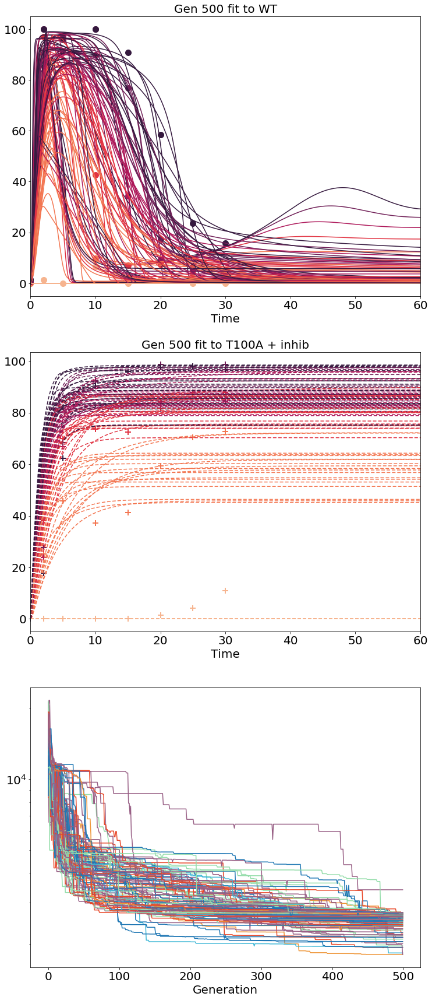

In [103]:
#initialize figure:
plt.clf()
fig, (ax1,ax2,ax3) = plt.subplots(3, 1, figsize=(12,30))


#plot 1
title_text = 'Gen ' + str(gen) + ' fit to WT'
ax1.set_title(title_text, fontsize=20)
ax1.set_xlabel('Time', fontsize=20)
# ax1.set_ylabel('gene expression', fontsize=20)
# ax1.set_xlim([0,150])1
# ax1.set_ylim([0,15])
plt.rc('xtick', labelsize=20) 
plt.rc('ytick', labelsize=20)
color_palette = sns.color_palette("rocket", 6)[::-1]

# plot real data:
for idx, wt_data in enumerate(mapk_wt_data):
    ax1.plot(mapk_time, wt_data, 'o', markersize=10, color=color_palette[idx])
#     ax1.plot(mapk_time, t100a_data, '+', mew=2, markersize=10, color=color_palette[idx])

# plot evolutionary algorithm data:
unstable = 0
for idx in idx_top[:plt_top]:
    learned_params = params_from_file[idx][gen]
    for idx, sig in enumerate(params_constants[-1]):
        params_c = params_constants[:-1]+[sig]
        data = simulate_wt_experiment_a2_2D_Y(initals, params_c, learned_params, time)
        active = data[:,2]/params_constants[2]*100
        if len([*filter(lambda x: x <= 100, active)]) == len(active) and len([*filter(lambda x: x >= 0, active)]) == len(active):
            ax1.plot(time, active, color=color_palette[idx])
        else:
            unstable += 1
# ax1.set_ylim(0, 100)
ax1.set_xlim(0,60)
print('# of unstable WT experiments: ' + str(unstable) + ' of ' + str(plt_top*6))
# ax1.legend(bbox_to_anchor=[1, 0.5], loc='center left')

#plot 2
title_text = 'Gen ' + str(gen) +  ' fit to T100A + inhib'
ax2.set_title(title_text, fontsize=20)
ax2.set_xlabel('Time', fontsize=20)

for idx, t100a_data in enumerate(mapk_t100a_data):
    ax2.plot(mapk_time, t100a_data, '+', mew=2, markersize=10, color=color_palette[idx])
    
# plot evolutionary algorithm data:
unstable = 0
for idx in idx_top[:plt_top]:
    learned_params = params_from_file[idx][gen]
    for idx, sig in enumerate(params_constants[-1]):
        params_c = params_constants[:-1]+[sig]
#         print(params_c)
        data = simulate_t100a_experiment_a2_2D_Y(initals, params_c, learned_params, time)
        active = data[:,2]/params_constants[2]*100
        if len([*filter(lambda x: x <= 100, active)]) == len(active) and len([*filter(lambda x: x >= 0, active)]) == len(active):
            ax2.plot(time, active, dashes= [4,2], color=color_palette[idx], label = 'ppMAPK at '  + str(sig))
        else:
            unstable += 1
# ax1.set_ylim(0, 100)
ax2.set_xlim(0,60)
print('# of unstable T100A experiments: ' + str(unstable) + ' of ' + str(plt_top*6))
# ax2.legend(bbox_to_anchor=[1, 0.5], loc='center left')
#plot2    
ax3.set_xlabel('Generation', fontsize=20)
# ax2.set_ylabel('Sum of MSE', fontsize=20)
# ax3.set_yscale('log')
# ax2.set_xlim([0,gen])
# ax2.set_ylim([10**3,10**5])
for idx in idx_top:
    ax3.semilogy([x for x in range(gen)], mse[idx][:gen])
    

plt.show()

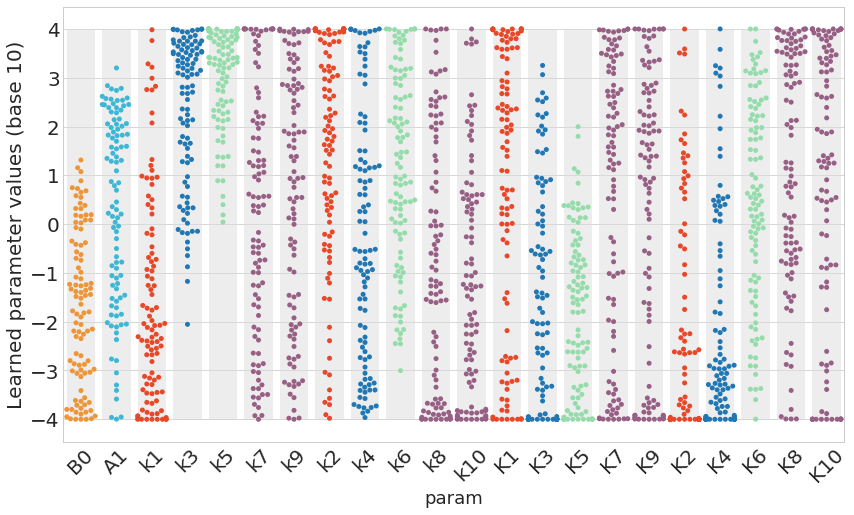

In [104]:
plt.rcParams['figure.figsize'] = [14.0, 8.0]

# positive 3db7d6
# negative ee9537
# hog1 ? 38bf85 or 94ddaa

colors = ['#ee9537', '#3db7d6',
          '#e84728','#1f77b4','#94ddaa','#985f85', '#985f85',
          '#e84728','#1f77b4','#94ddaa','#985f85', '#985f85',
          '#e84728', '#1f77b4','#94ddaa','#985f85', '#985f85',
          '#e84728','#1f77b4','#94ddaa','#985f85', '#985f85']

pal = sns.set_palette(colors)

with sns.axes_style("whitegrid"):
    plt.bar(range(0,len(labelnames)),height=diff,bottom=mins,align='center',tick_label=labelnames, color='#DCDCDC',alpha = 0.5)
    x = sns.swarmplot(x='param',y='vals', data = df_top_params_log_M)
    x.set_xticklabels(labelnames,rotation=45)
#     plt.xlabel('Parameters', fontsize=20)
    plt.ylabel('Learned parameter values (base 10)', fontsize=20)
#     ax.yaxis.set_major_locator(ticker.MultipleLocator(2))

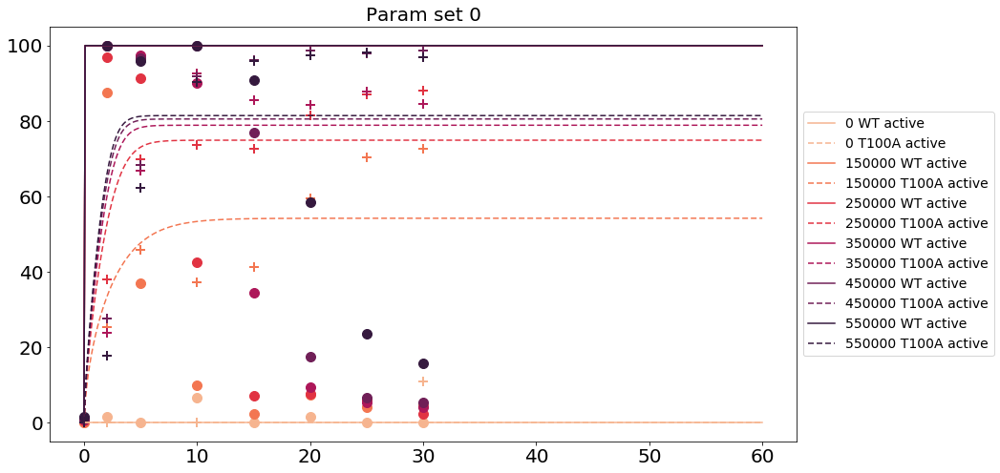

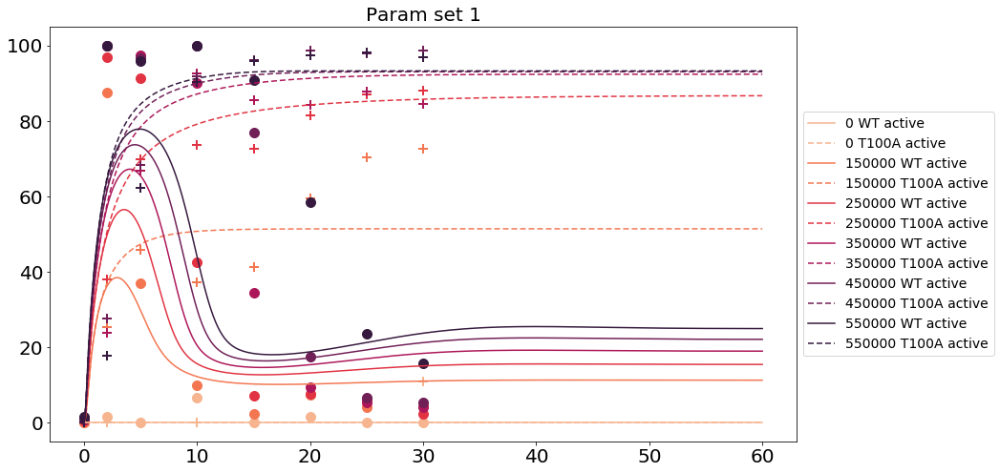

KeyboardInterrupt: 

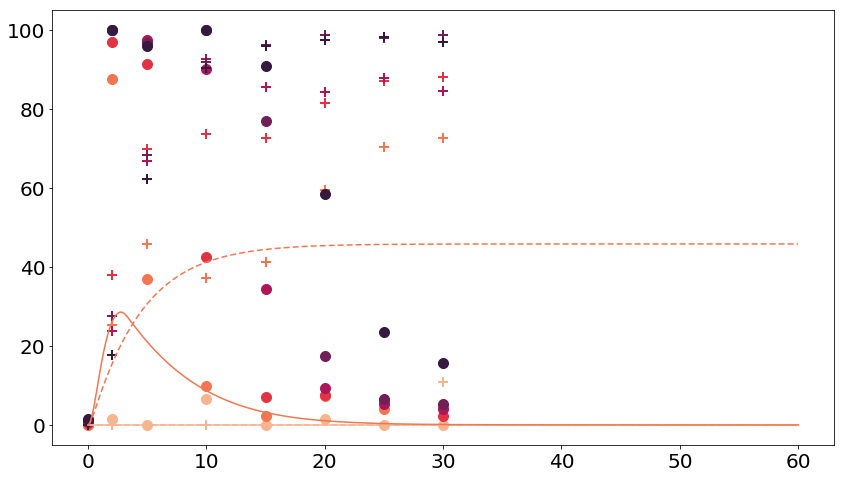

In [304]:
color_palette = sns.color_palette("rocket", 6)[::-1]

for i, params in enumerate(top_params):
#     beta_1, beta_2, alpha, k1, k2, k3, k4, k5, k6, k7, k8, K_1, K_2, K_3, K_4, K_5, K_6, K_7, K_8, kn, kc = params
#     params = beta_1, beta_2, 0, k1, k2, k3, k4, k5, k6, k7, k8, K_1, K_2, K_3, K_4, K_5, K_6, K_7, K_8, 0, kc
    #plot real data:
    for idx, (wt_data,t100a_data) in enumerate(zip(mapk_wt_data, mapk_t100a_data)):
        plt.plot(mapk_time, wt_data, 'o', markersize=10, color=color_palette[idx])
        plt.plot(mapk_time, t100a_data, '+', mew=2, markersize=10, color=color_palette[idx])
    for idx, signal in enumerate(s):
        data = odeint(b0_a3_2D_Y, initals, time, args=(params_constants[:-1]+[signal], params))
#         data = simulate_wt_experiment_a1_2D_Y(initals, params_constants[:-1]+[signal], params, time)
        active = data[:,2]/params_constants[2]*100
        plt.plot(time, active, label=str(signal)+' WT active', color=color_palette[idx])
#         plt.plot(time, data[:,4], dashes=[2, 2], label=str(signal)+' X')
        data = simulate_t100a_experiment_a2_2D_Y(initals, params_constants[:-1]+[signal], params, time)
        active = data[:,2]/params_constants[2]*100
        plt.plot(time, active, label=str(signal)+' T100A active', dashes= [4,2], color=color_palette[idx])
#         plt.plot(time, data[:,3], label=str(signal)+' MAPKn')
    plt.title(f'Param set {i}')
    plt.legend(bbox_to_anchor=[1, 0.5], loc='center left')
#     plt.ylim(0,100)
    plt.show()

# Two step delay a3 uM

## Functions

In [7]:
def b0_a3_2D_Y(initals,t,params_constants,params):
    MAP3K, MAP2K, MAPK, X, Y = initals
    MAP3K_t, MAP2K_t, MAPK_t, X_t, Y_t, s = params_constants
    beta_0, alpha_3, k1, k3, k5, k7, k9, k2, k4, k6, k8, k10, K_1, K_3, K_5, K_7, K_9, K_2, K_4, K_6, K_8, K_10 = params

    MAP3K_I = MAP3K_t-MAP3K
    MAP2K_I = MAP2K_t-MAP2K
    MAPK_I = MAPK_t-MAPK
    X_I = X_t-X
    Y_I = Y_t-Y

    dMAP3K = (s/(1+Y/beta_0)) * (((k1+alpha_3*MAPK)*MAP3K_I)/(K_1+MAP3K_I)) - (k2*MAP3K/(K_2+MAP3K))
    dMAP2K = (((k3*MAP3K)*MAP2K_I)/(K_3+MAP2K_I)) - (k4*MAP2K/(K_4+MAP2K))
    dMAPK = (((k5*MAP2K)*MAPK_I)/(K_5+MAPK_I)) - (k6*MAPK/(K_6+MAPK))
    dX = ((k7*MAPK*X_I) / (K_7+X_I)) - (k8*X/(K_8+X))
    dY = ((k9*X*Y_I) / (K_9+X_I)) - (k10*Y/(K_10+Y))

    return dMAP3K, dMAP2K, dMAPK, dX, dY


def simulate_wt_experiment_a3_2D_Y(inits, params_constants, learned_params, time):
    # parameters to be learned - inits
    # parameters to be kept constant - params_constants
    # parameters to be learned - learned_params

    #solve odes:
    odes = odeint(b0_a3_2D_Y, inits, time, args=(params_constants, learned_params))

    return odes

def simulate_t100a_experiment_a3_2D_Y(inits, params_constants, learned_params, time):
    # parameters to be learned - inits
    # parameters to be kept constant - params_constants
    # parameters to be learned - learned_params
    beta_0, alpha_3, k1, k3, k5, k7, k9, k2, k4, k6, k8, k10, K_1, K_3, K_5, K_7, K_9, K_2, K_4, K_6, K_8, K_10  = learned_params
    learned_params = beta_0, 0, k1, k3, k5, 0, k9, k2, k4, k6, k8, k10, K_1, K_3, K_5, K_7, K_9, K_2, K_4, K_6, K_8, K_10
    #solve odes:
    odes = odeint(b0_a3_2D_Y, inits, time, args=(params_constants, learned_params))
    
    return odes


## Input

In [8]:
folder = 'C:/Users/sksuzuki/Desktop/killdevil/from/180917_b0_a3_2D_k7_Y_uM'
mins = [-4, -4,
        -4, -4, -4, -4, -4,
        -4, -4, -4, -4, -4,
        -4, -4, -4, -4, -4,
        -4, -4, -4, -4, -4]

maxs = [4, 4,
        4, 4, 4, 4, 4,
        4, 4, 4, 4, 4,
        4, 4, 4, 4, 4,
        4, 4, 4, 4, 4]

# folder = 'C:/Users/sksuzuki/Desktop/killdevil/from/180928_b0_a3_2D_k7_Y_uM'
# mins = [-8, -8,
#         -5, -5, -5, -5, -4,
#         -6, -6, -6, -6, -4,
#         -4, -4, -4, -4, -4,
#         -4, -4, -4, -4, -4]
# maxs = [4, 8,
#         4, 1, 1, 1, 4,
#         4, 0, 0, 0, 4,
#         4, 4, 4, 4, 4,
#         4, 4, 4, 4, 4]


gen = 500
runs = 2000

MAP3K = 0
MAP2K = 0
MAPK = 0
X = 0
Y = 0

# Protein concentrations (uM)
MAP3K_t = molarity_conversion(1170)
MAP2K_t = molarity_conversion(2282)
MAPK_t = molarity_conversion(5984)
X_t = 100
Y_t = 100

s = [0, 150000, 250000, 350000, 450000, 550000]


labelnames = ['B0', 'A3',
              'k1', 'k3', 'k5', 'k7', 'k9',
              'k2', 'k4', 'k6', 'k8', 'k10',
              'K1', 'K3', 'K5', 'K7', 'K9',
              'K2', 'K4', 'K6', 'K8', 'K10']



diff = np.asarray(maxs)-np.asarray(mins)

# fb = 1
# t100a_fb = 0

initals = [MAP3K, MAP2K, MAPK, X, Y]
params_constants = [MAP3K_t, MAP2K_t, MAPK_t, X_t, Y_t, s]
    
dt = 0.1
steps = 600
time = np.linspace(0,dt*steps,steps)

## Gather simulated data

In [9]:
mse = []
params_from_file = []

empty_data = 0
for loaded_data in pathlib.Path(folder).glob('*.pickled'):
    if os.path.getsize(loaded_data) > 0:
        with open(loaded_data, 'rb') as f:
            new_data = pickle.load(f)
            mse.append(np.asarray(new_data[0]))
            params_from_file.append(np.asarray(new_data[1]))
    else:
        empty_data += 1

top = round((runs-empty_data)*0.05)
plt_top = round((runs-empty_data)*0.01)      
    
new_params = []
last_mses = []
for i in range(len(params_from_file)):
    new_params.append(params_from_file[i][gen])
    last_mses.append(mse[i][gen])
last_mses = np.asarray(last_mses)
new_params = np.asarray(new_params)
new_params = new_params.T

idx_top = last_mses.argsort()[:top]

top_params_a3 = [([new_params[i][x] for i in range(len(new_params))]) for x in idx_top]
# top_params = []
# for idx in idx_top:
#     top_params.append(params_from_file[idx][100])

print('Best MSE: ' + str(np.min([mse[idx][gen] for idx in idx_top])))

Best MSE: 811.386005514


In [10]:
df_top_params = pd.DataFrame(top_params_a3)
df_top_params.columns = labelnames
df_top_params_log = df_top_params.apply(np.log10)
df_top_params_log_M = df_top_params_log.melt(var_name='param', value_name='vals')

## Plot 

# of unstable WT experiments: 0 of 120
# of unstable T100A experiments: 0 of 120


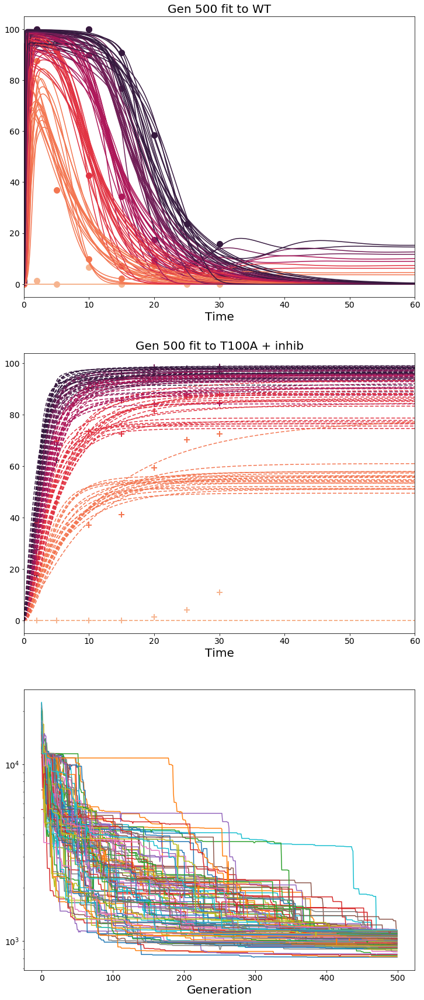

In [11]:
#initialize figure:
plt.clf()
fig, (ax1,ax2,ax3) = plt.subplots(3, 1, figsize=(12,30))


#plot 1
title_text = 'Gen ' + str(gen) + ' fit to WT'
ax1.set_title(title_text, fontsize=20)
ax1.set_xlabel('Time', fontsize=20)
# ax1.set_ylabel('gene expression', fontsize=20)
# ax1.set_xlim([0,150])1
# ax1.set_ylim([0,15])
plt.rc('xtick', labelsize=20) 
plt.rc('ytick', labelsize=20)
color_palette = sns.color_palette("rocket", 6)[::-1]

# plot real data:
for idx, wt_data in enumerate(mapk_wt_data):
    ax1.plot(mapk_time, wt_data, 'o', markersize=10, color=color_palette[idx])
#     ax1.plot(mapk_time, t100a_data, '+', mew=2, markersize=10, color=color_palette[idx])

# plot evolutionary algorithm data:
unstable = 0
for idx in idx_top[:plt_top]:
    learned_params = params_from_file[idx][gen]
    for idx, sig in enumerate(params_constants[-1]):
        params_c = params_constants[:-1]+[sig]
        data = simulate_wt_experiment_a3_2D_Y(initals, params_c, learned_params, time)
        active = data[:,2]/params_constants[2]*100
        if len([*filter(lambda x: x <= 100, active)]) == len(active) and len([*filter(lambda x: x >= 0, active)]) == len(active):
            ax1.plot(time, active, color=color_palette[idx])
        else:
            unstable += 1
# ax1.set_ylim(0, 100)
ax1.set_xlim(0,60)
print('# of unstable WT experiments: ' + str(unstable) + ' of ' + str(plt_top*6))
# ax1.legend(bbox_to_anchor=[1, 0.5], loc='center left')

#plot 2
title_text = 'Gen ' + str(gen) +  ' fit to T100A + inhib'
ax2.set_title(title_text, fontsize=20)
ax2.set_xlabel('Time', fontsize=20)

for idx, t100a_data in enumerate(mapk_t100a_data):
    ax2.plot(mapk_time, t100a_data, '+', mew=2, markersize=10, color=color_palette[idx])
    
# plot evolutionary algorithm data:
unstable = 0
for idx in idx_top[:plt_top]:
    learned_params = params_from_file[idx][gen]
    for idx, sig in enumerate(params_constants[-1]):
        params_c = params_constants[:-1]+[sig]
#         print(params_c)
        data = simulate_t100a_experiment_a3_2D_Y(initals, params_c, learned_params, time)
        active = data[:,2]/params_constants[2]*100
        if len([*filter(lambda x: x <= 100, active)]) == len(active) and len([*filter(lambda x: x >= 0, active)]) == len(active):
            ax2.plot(time, active, dashes= [4,2], color=color_palette[idx], label = 'ppMAPK at '  + str(sig))
        else:
            unstable += 1
# ax1.set_ylim(0, 100)
ax2.set_xlim(0,60)
print('# of unstable T100A experiments: ' + str(unstable) + ' of ' + str(plt_top*6))
# ax2.legend(bbox_to_anchor=[1, 0.5], loc='center left')
#plot2    
ax3.set_xlabel('Generation', fontsize=20)
# ax2.set_ylabel('Sum of MSE', fontsize=20)
# ax3.set_yscale('log')
# ax2.set_xlim([0,gen])
# ax2.set_ylim([10**3,10**5])
for idx in idx_top:
    ax3.semilogy([x for x in range(gen)], mse[idx][:gen])
    

plt.show()

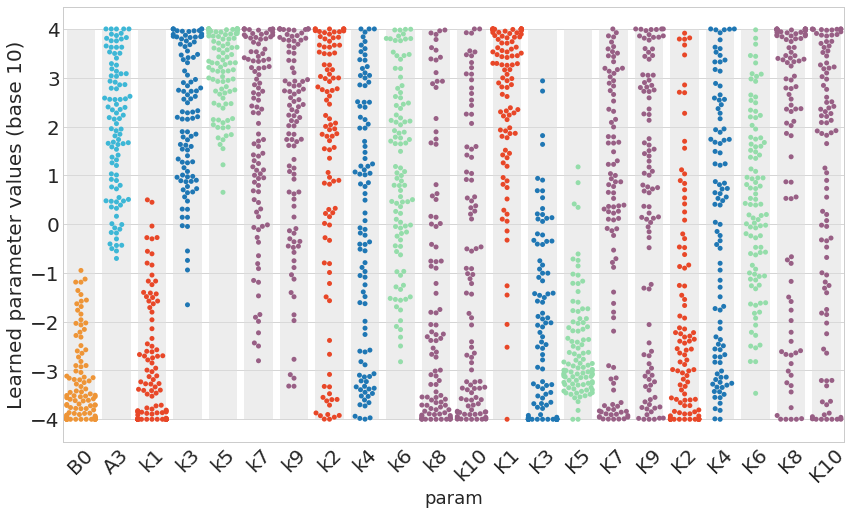

In [60]:
plt.rcParams['figure.figsize'] = [14.0, 8.0]

# positive 3db7d6
# negative ee9537
# hog1 ? 38bf85 or 94ddaa

colors = ['#ee9537', '#3db7d6',
          '#e84728','#1f77b4','#94ddaa','#985f85', '#985f85',
          '#e84728','#1f77b4','#94ddaa','#985f85', '#985f85',
          '#e84728', '#1f77b4','#94ddaa','#985f85', '#985f85',
          '#e84728','#1f77b4','#94ddaa','#985f85', '#985f85']

pal = sns.set_palette(colors)

with sns.axes_style("whitegrid"):
    plt.bar(range(0,len(labelnames)),height=diff,bottom=mins,align='center',tick_label=labelnames, color='#DCDCDC',alpha = 0.5)
    x = sns.swarmplot(x='param',y='vals', data = df_top_params_log_M)
    x.set_xticklabels(labelnames,rotation=45)
#     plt.xlabel('Parameters', fontsize=20)
    plt.ylabel('Learned parameter values (base 10)', fontsize=20)
#     ax.yaxis.set_major_locator(ticker.MultipleLocator(2))

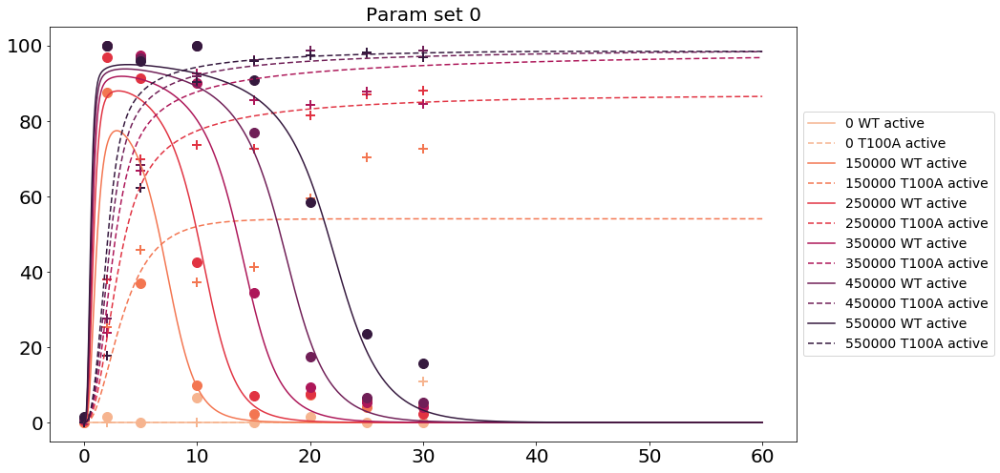

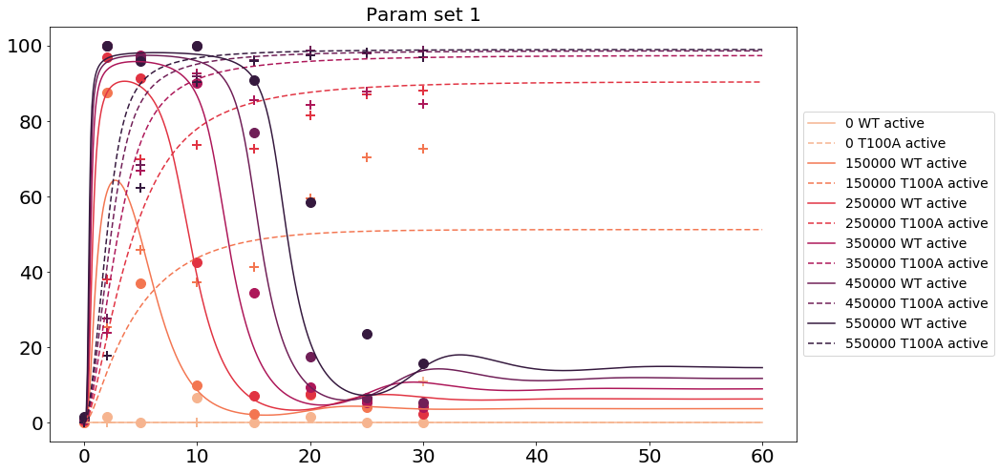

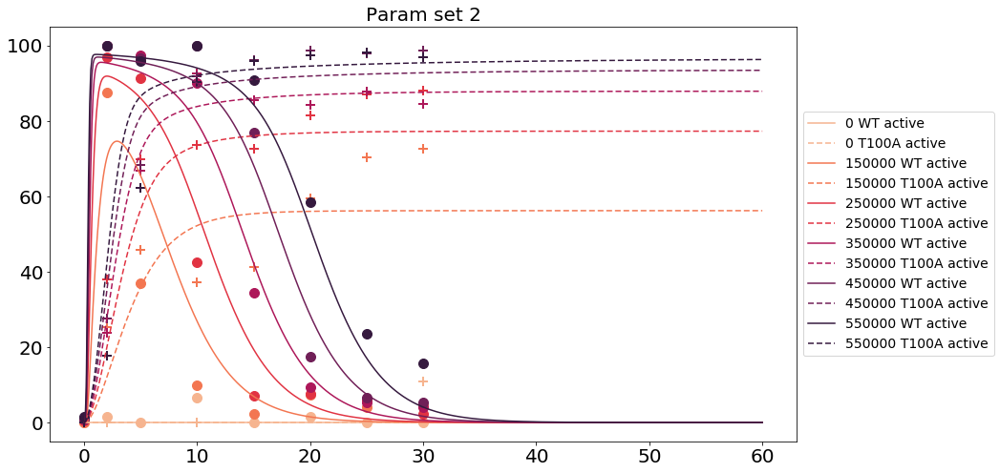

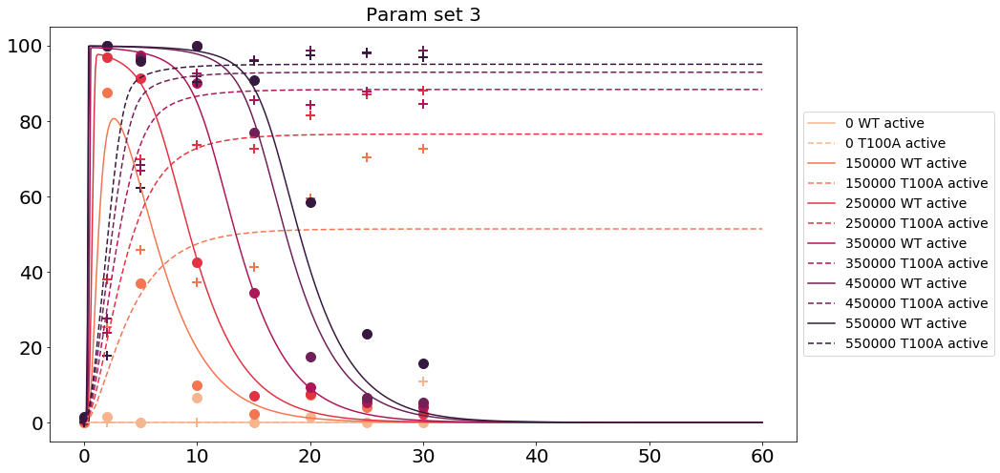

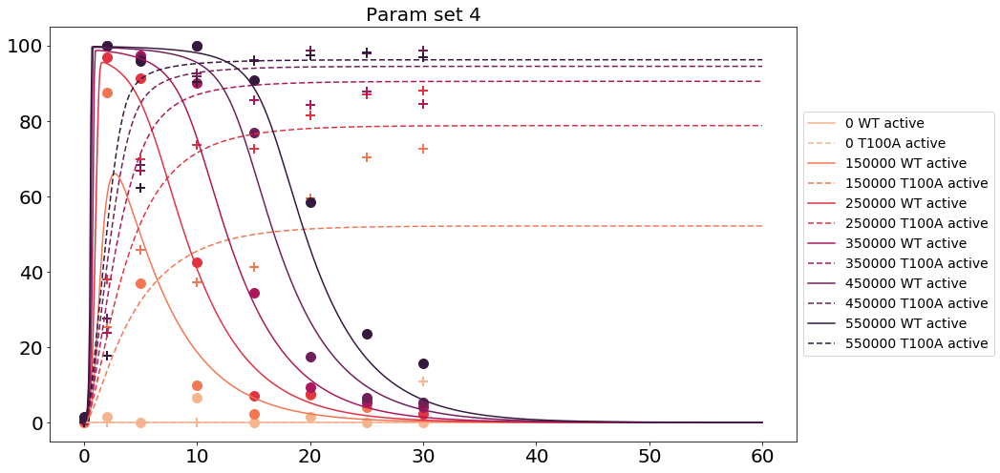

...

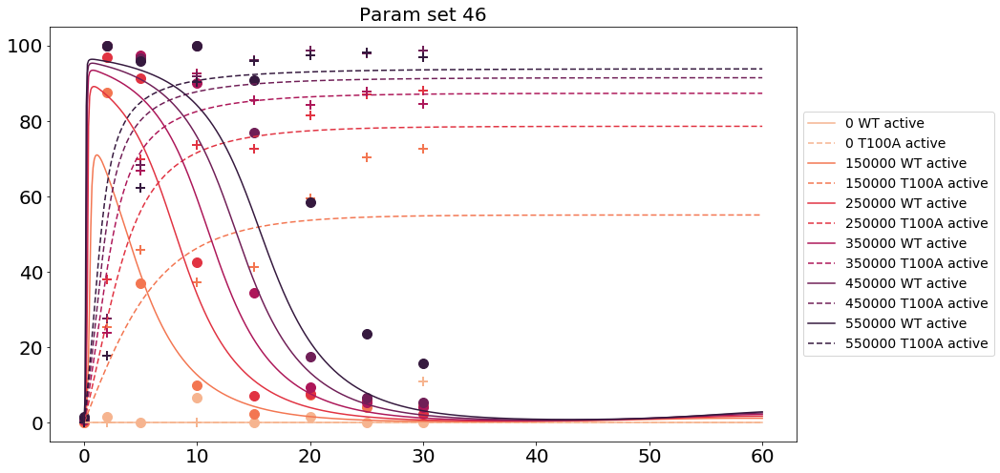

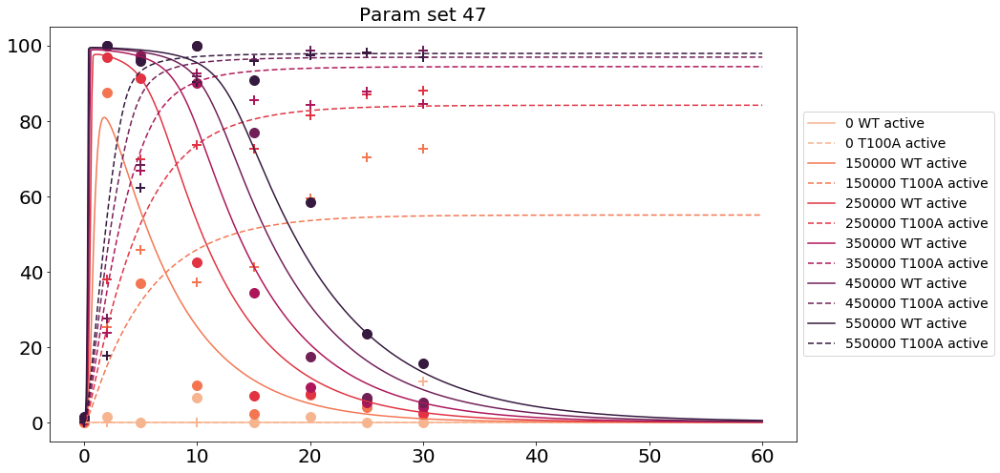

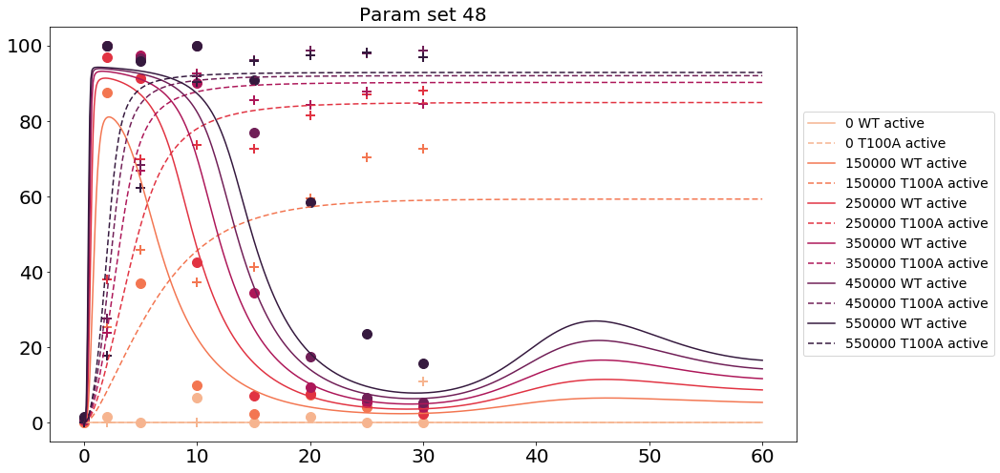

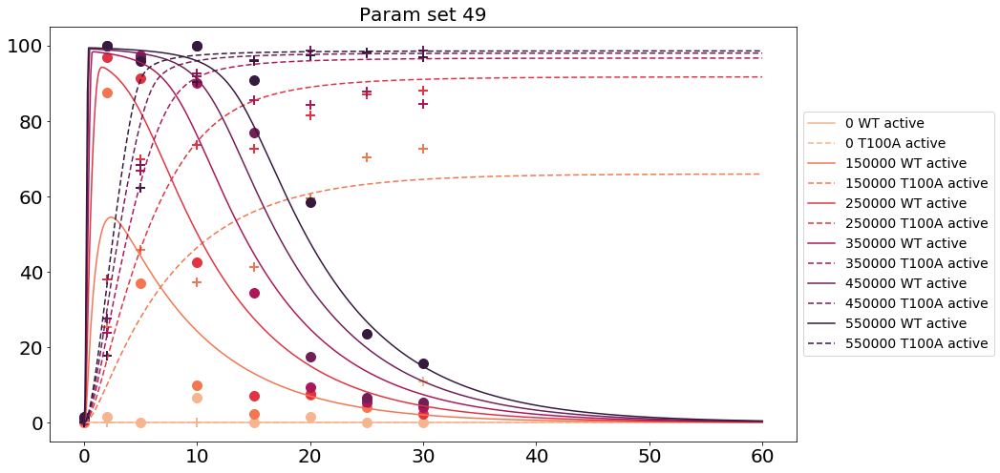

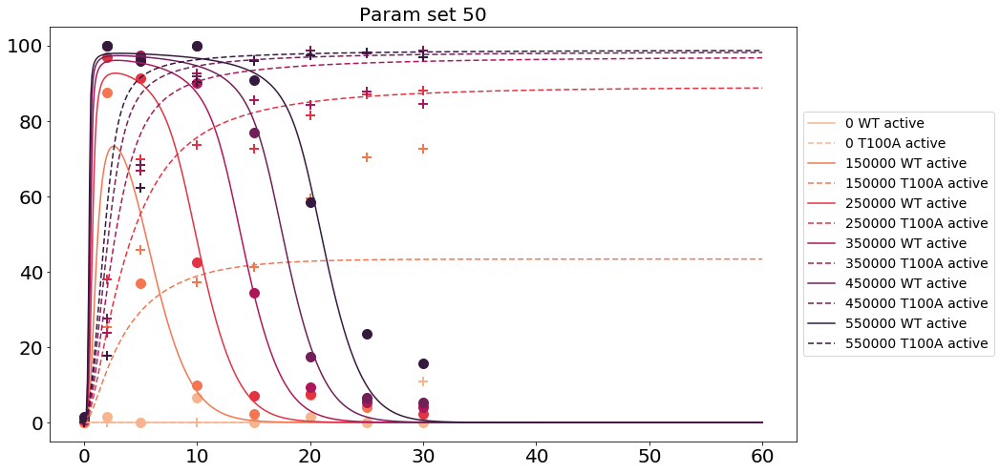

C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\integrate\odepack.py:218: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)


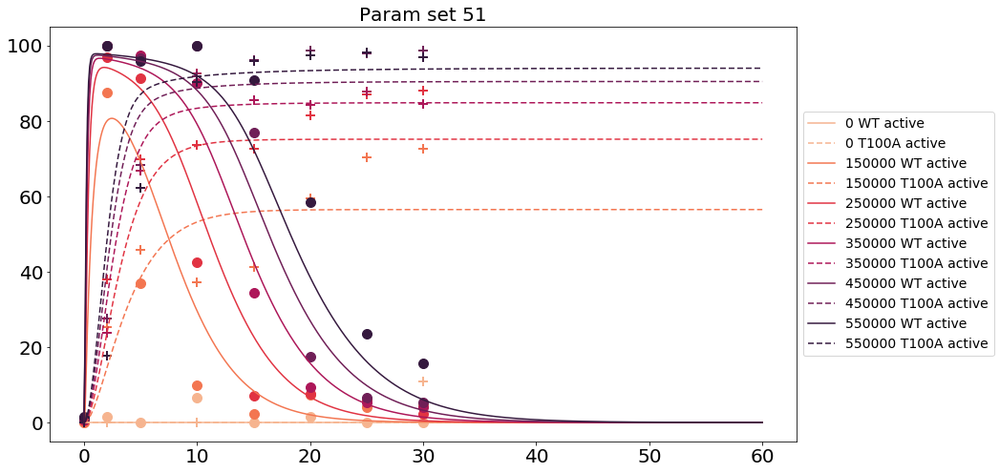

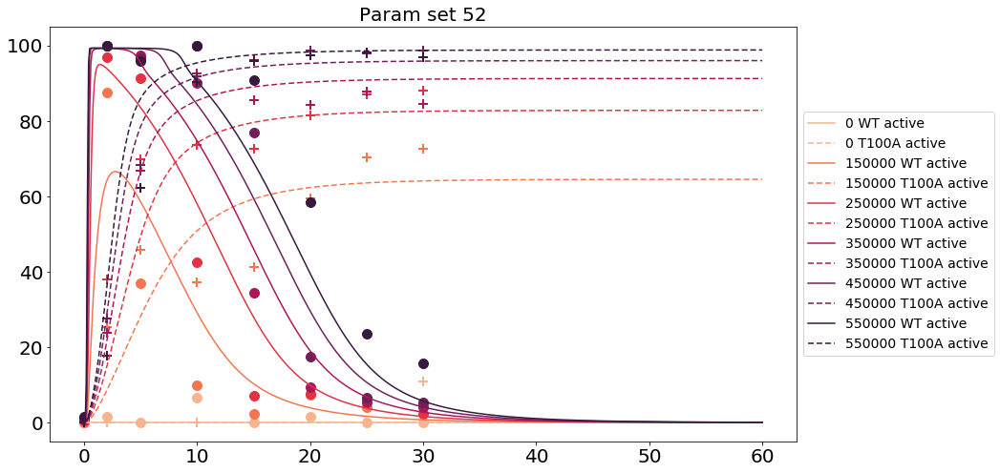

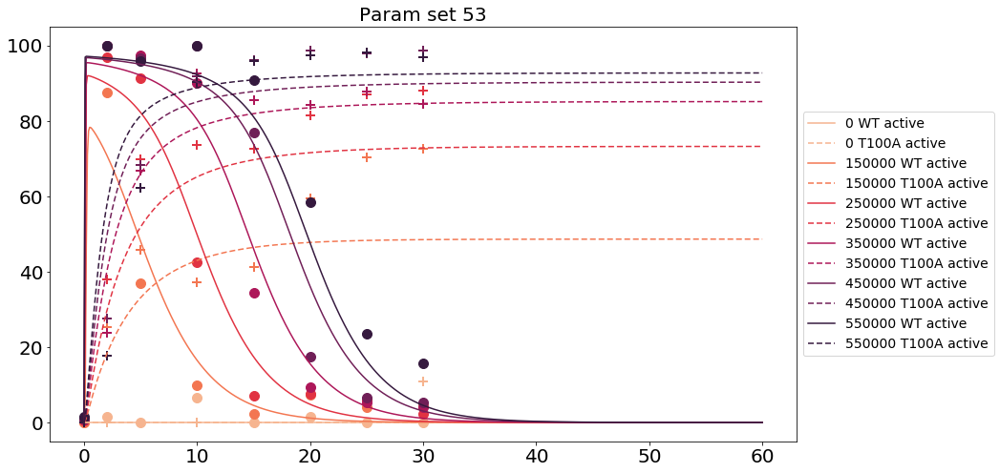

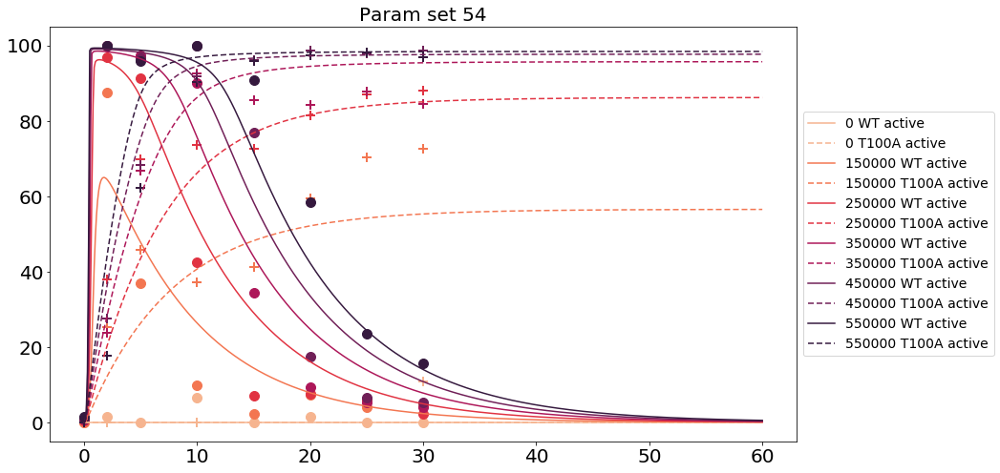

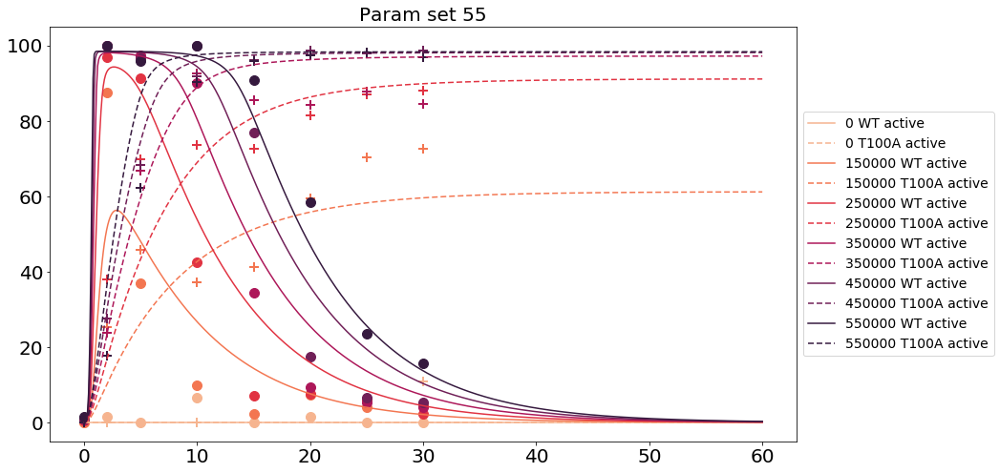

...

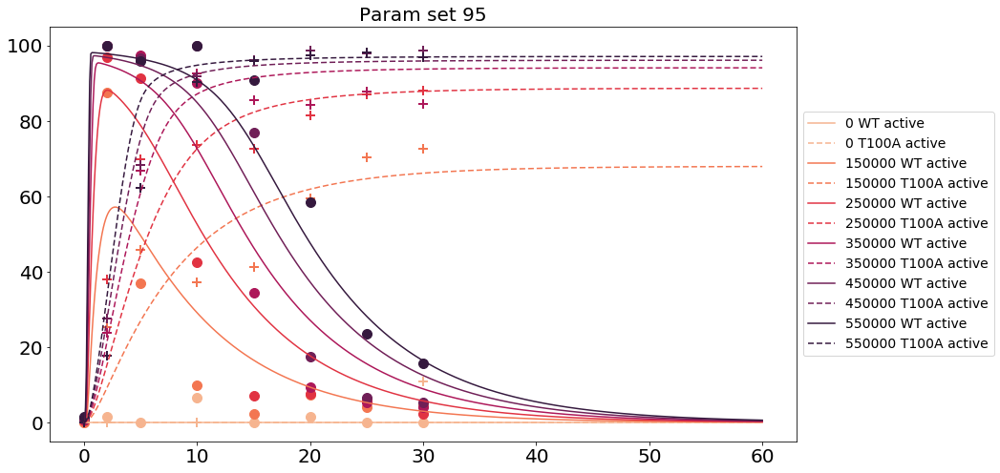

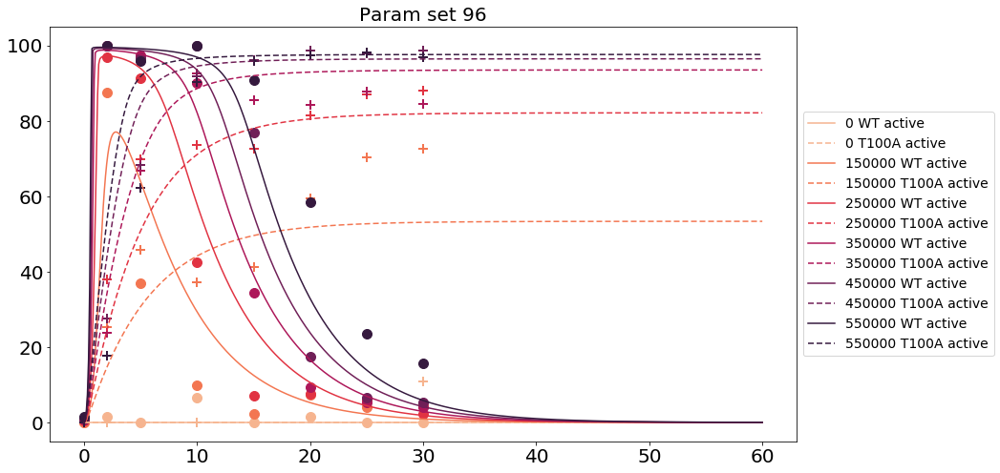

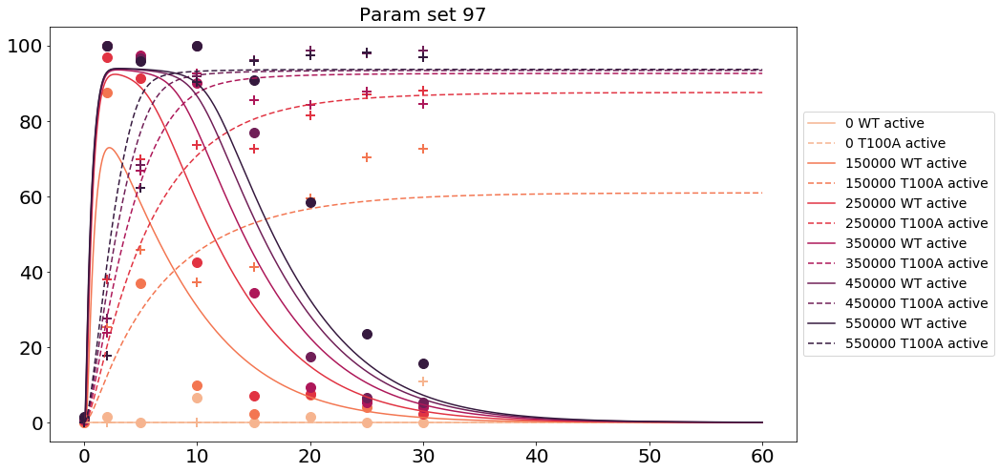

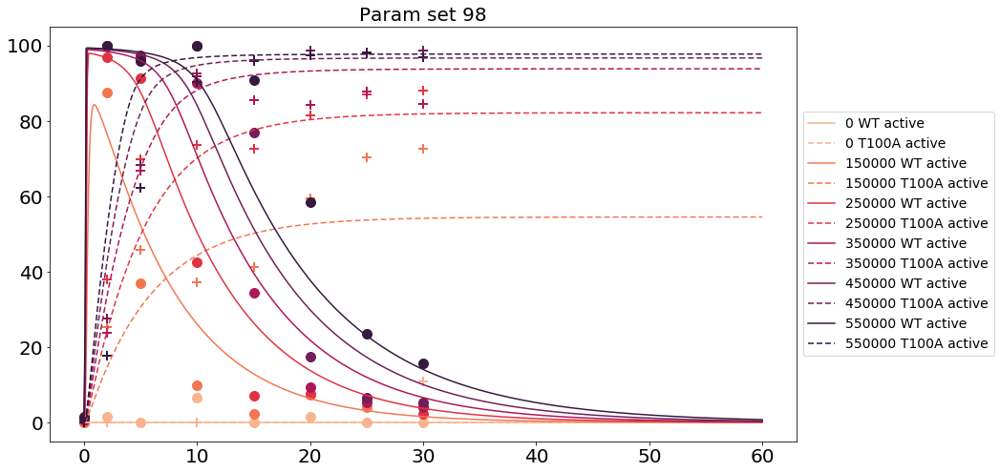

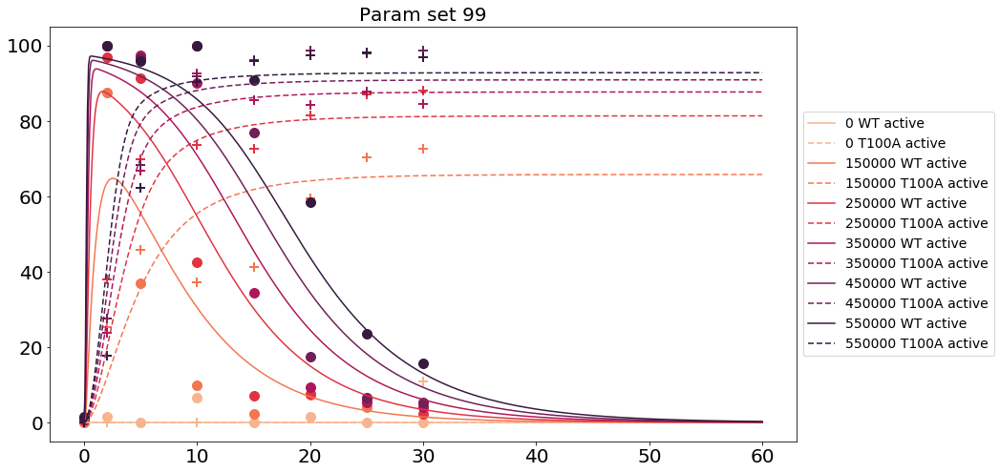

In [316]:
color_palette = sns.color_palette("rocket", 6)[::-1]

for i, params in enumerate(top_params):
#     beta_1, beta_2, alpha, k1, k2, k3, k4, k5, k6, k7, k8, K_1, K_2, K_3, K_4, K_5, K_6, K_7, K_8, kn, kc = params
#     params = beta_1, beta_2, 0, k1, k2, k3, k4, k5, k6, k7, k8, K_1, K_2, K_3, K_4, K_5, K_6, K_7, K_8, 0, kc
    #plot real data:
    for idx, (wt_data,t100a_data) in enumerate(zip(mapk_wt_data, mapk_t100a_data)):
        plt.plot(mapk_time, wt_data, 'o', markersize=10, color=color_palette[idx])
        plt.plot(mapk_time, t100a_data, '+', mew=2, markersize=10, color=color_palette[idx])
    for idx, signal in enumerate(s):
        data = odeint(b0_a3_2D_Y, initals, time, args=(params_constants[:-1]+[signal], params))
#         data = simulate_wt_experiment_a1_2D_Y(initals, params_constants[:-1]+[signal], params, time)
        active = data[:,2]/params_constants[2]*100
        plt.plot(time, active, label=str(signal)+' WT active', color=color_palette[idx])
#         plt.plot(time, data[:,4], dashes=[2, 2], label=str(signal)+' X')
        data = simulate_t100a_experiment_a3_2D_Y(initals, params_constants[:-1]+[signal], params, time)
        active = data[:,2]/params_constants[2]*100
        plt.plot(time, active, label=str(signal)+' T100A active', dashes= [4,2], color=color_palette[idx])
#         plt.plot(time, data[:,3], label=str(signal)+' MAPKn')
    plt.title(f'Param set {i}')
    plt.legend(bbox_to_anchor=[1, 0.5], loc='center left')
#     plt.ylim(0,100)
    plt.show()

In [33]:
def test(n):
    return n + 1 

def test2(x,y):
    return x(y)*2

test2(test,1)

4

# Change Signal

In [12]:
def b0_a1_2D_Y_fancy(initals,t,params_constants,params, signal_fxn, fxn_params):
    MAP3K, MAP2K, MAPK, X, Y = initals
    MAP3K_t, MAP2K_t, MAPK_t, X_t, Y_t = params_constants
    beta_0, alpha_1, k1, k3, k5, k7, k9, k2, k4, k6, k8, k10, K_1, K_3, K_5, K_7, K_9, K_2, K_4, K_6, K_8, K_10 = params
    
    s = signal_fxn(t,fxn_params[1],fxn_params[2])

    MAP3K_I = MAP3K_t-MAP3K
    MAP2K_I = MAP2K_t-MAP2K
    MAPK_I = MAPK_t-MAPK
    X_I = X_t-X
    Y_I = Y_t-Y

    dMAP3K = (s/(1+Y/beta_0)) * (((k1)*MAP3K_I)/(K_1+MAP3K_I)) - (k2*MAP3K/(K_2+MAP3K))
    dMAP2K = (((k3*MAP3K)*MAP2K_I)/(K_3+MAP2K_I)) - (k4*MAP2K/(K_4+MAP2K))
    dMAPK = (((k5*MAP2K+alpha_1*MAPK)*MAPK_I)/(K_5+MAPK_I)) - (k6*MAPK/(K_6+MAPK))
    dX = ((k7*MAPK*X_I) / (K_7+X_I)) - (k8*X/(K_8+X))
    dY = ((k9*X*Y_I) / (K_9+X_I)) - (k10*Y/(K_10+Y))

    return dMAP3K, dMAP2K, dMAPK, dX, dY

def b0_a2_2D_Y_fancy(initals,t,params_constants,params, signal_fxn, fxn_params):
    MAP3K, MAP2K, MAPK, X, Y = initals
    MAP3K_t, MAP2K_t, MAPK_t, X_t, Y_t = params_constants
    beta_0, alpha_2, k1, k3, k5, k7, k9, k2, k4, k6, k8, k10, K_1, K_3, K_5, K_7, K_9, K_2, K_4, K_6, K_8, K_10 = params
    
    s = signal_fxn(t,fxn_params[1],fxn_params[2])

    MAP3K_I = MAP3K_t-MAP3K
    MAP2K_I = MAP2K_t-MAP2K
    MAPK_I = MAPK_t-MAPK
    X_I = X_t-X
    Y_I = Y_t-Y

    dMAP3K = (s/(1+Y/beta_0)) * (((k1)*MAP3K_I)/(K_1+MAP3K_I)) - (k2*MAP3K/(K_2+MAP3K))
    dMAP2K = (((k3*MAP3K+alpha_2*MAPK)*MAP2K_I)/(K_3+MAP2K_I)) - (k4*MAP2K/(K_4+MAP2K))
    dMAPK = (((k5*MAP2K)*MAPK_I)/(K_5+MAPK_I)) - (k6*MAPK/(K_6+MAPK))
    dX = ((k7*MAPK*X_I) / (K_7+X_I)) - (k8*X/(K_8+X))
    dY = ((k9*X*Y_I) / (K_9+X_I)) - (k10*Y/(K_10+Y))

    return dMAP3K, dMAP2K, dMAPK, dX, dY

def b0_a3_2D_Y_fancy(initals,t,params_constants,params, signal_fxn, fxn_params):
    MAP3K, MAP2K, MAPK, X, Y = initals
    MAP3K_t, MAP2K_t, MAPK_t, X_t, Y_t = params_constants
    beta_0, alpha_3, k1, k3, k5, k7, k9, k2, k4, k6, k8, k10, K_1, K_3, K_5, K_7, K_9, K_2, K_4, K_6, K_8, K_10 = params
    
    s = signal_fxn(t,fxn_params[1],fxn_params[2])

    MAP3K_I = MAP3K_t-MAP3K
    MAP2K_I = MAP2K_t-MAP2K
    MAPK_I = MAPK_t-MAPK
    X_I = X_t-X
    Y_I = Y_t-Y

    dMAP3K = (s/(1+Y/beta_0)) * (((k1+alpha_3*MAPK)*MAP3K_I)/(K_1+MAP3K_I)) - (k2*MAP3K/(K_2+MAP3K))
    dMAP2K = (((k3*MAP3K)*MAP2K_I)/(K_3+MAP2K_I)) - (k4*MAP2K/(K_4+MAP2K))
    dMAPK = (((k5*MAP2K)*MAPK_I)/(K_5+MAPK_I)) - (k6*MAPK/(K_6+MAPK))
    dX = ((k7*MAPK*X_I) / (K_7+X_I)) - (k8*X/(K_8+X))
    dY = ((k9*X*Y_I) / (K_9+X_I)) - (k10*Y/(K_10+Y))

    return dMAP3K, dMAP2K, dMAPK, dX, dY

## Periodic

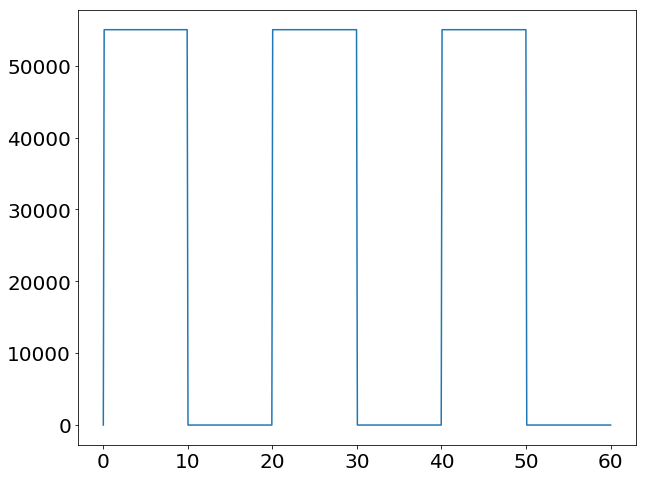

In [13]:
def signal_periodic(t_step, signal, period):
    if t_step == 0:
        s = 0
    elif t_step >= 60:
        s = 0
    elif np.floor(t_step / period) % 2 == 0:
        s =  signal
    else:
        s = 0
#     signal = 
#     print(len_period)
    return s
# [signal_periodic(x, 55000, 20) for x in time]

plt.plot(time, [signal_periodic(x, 55000, 10) for x in time])

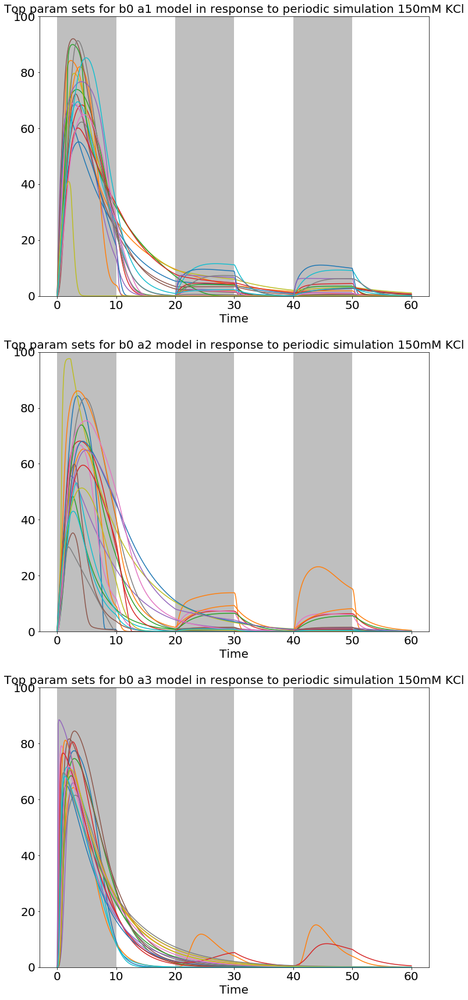

In [23]:
#initialize figure:
plt.clf()
fig, (ax1,ax2,ax3) = plt.subplots(3, 1, figsize=(12,30))
plt.rc('xtick', labelsize=20) 
plt.rc('ytick', labelsize=20)

initals = [MAP3K, MAP2K, MAPK, X, Y]
params_constants = [MAP3K_t, MAP2K_t, MAPK_t, X_t, Y_t]


#plot 1
title_text = 'Top param sets for b0 a1 model in response to periodic simulation 150mM KCl'
ax1.set_title(title_text, fontsize=20)
ax1.set_xlabel('Time', fontsize=20)

for idx, param_set in enumerate(top_params_a1[:20]):
    data = odeint(b0_a1_2D_Y_fancy, initals, time, args=(params_constants, param_set,signal_periodic,[_, 150000, 10]))
    ax1.plot(time,data[:,2]/params_constants[2]*100,label=str(idx))
    
ax1.set_ylim(0,100)
for x in range(0,60,20):
    ax1.fill_between([x,x+10], 0, 550, facecolor='gray', alpha=0.5)
# ax1.legend()
    
    
#plot2
title_text = 'Top param sets for b0 a2 model in response to periodic simulation 150mM KCl'
ax2.set_title(title_text, fontsize=20)
ax2.set_xlabel('Time', fontsize=20)

for idx, param_set in enumerate(top_params_a2[:20]):
    data = odeint(b0_a2_2D_Y_fancy, initals, time, args=(params_constants, param_set,signal_periodic,[_, 150000, 10]))
    ax2.plot(time,data[:,2]/params_constants[2]*100,label=str(idx))
    
ax2.set_ylim(0,100)
for x in range(0,60,20):
    ax2.fill_between([x,x+10], 0, 550, facecolor='gray', alpha=0.5)
# ax2.legend()


#plot 3
title_text = 'Top param sets for b0 a3 model in response to periodic simulation 150mM KCl'
ax3.set_title(title_text, fontsize=20)
ax3.set_xlabel('Time', fontsize=20)

initals = [MAP3K, MAP2K, MAPK, X, Y]
params_constants = [MAP3K_t, MAP2K_t, MAPK_t, X_t, Y_t]

for idx, param_set in enumerate(top_params_a3[:20]):
    data = odeint(b0_a3_2D_Y_fancy, initals, time, args=(params_constants, param_set,signal_periodic,[_, 150000, 10]))
    ax3.plot(time,data[:,2]/params_constants[2]*100,label=str(idx))
    
ax3.set_ylim(0,100)
for x in range(0,60,20):
    ax3.fill_between([x,x+10], 0, 550, facecolor='gray', alpha=0.5)
# ax3.legend()
plt.show()

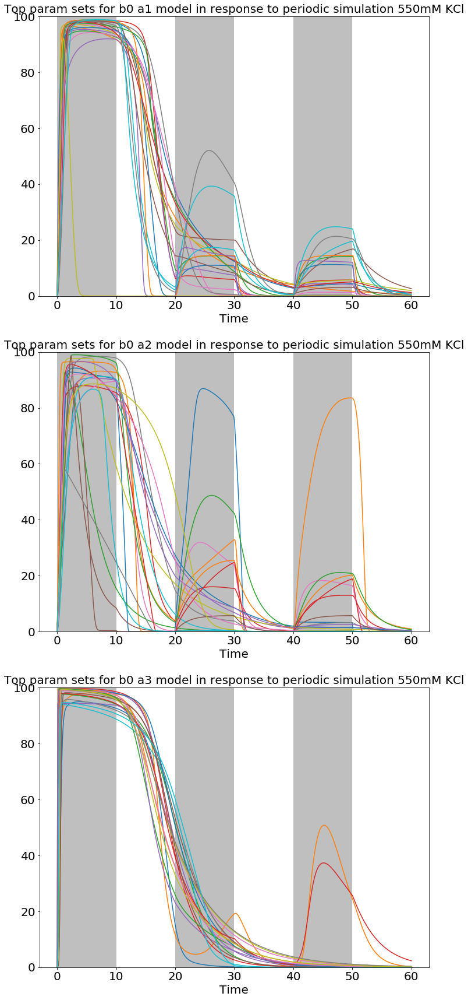

In [24]:
t = 20
#initialize figure:
plt.clf()
fig, (ax1,ax2,ax3) = plt.subplots(3, 1, figsize=(12,30))
plt.rc('xtick', labelsize=20) 
plt.rc('ytick', labelsize=20)

initals = [MAP3K, MAP2K, MAPK, X, Y]
params_constants = [MAP3K_t, MAP2K_t, MAPK_t, X_t, Y_t]


#plot 1
title_text = 'Top param sets for b0 a1 model in response to periodic simulation 550mM KCl'
ax1.set_title(title_text, fontsize=20)
ax1.set_xlabel('Time', fontsize=20)

for idx, param_set in enumerate(top_params_a1[:t]):
    data = odeint(b0_a1_2D_Y_fancy, initals, time, args=(params_constants, param_set,signal_periodic,[_, 550000, 10]))
    ax1.plot(time,data[:,2]/params_constants[2]*100,label=str(idx))
    
ax1.set_ylim(0,100)
for x in range(0,60,20):
    ax1.fill_between([x,x+10], 0, 550, facecolor='gray', alpha=0.5)
# ax1.legend()
    
    
#plot2
title_text = 'Top param sets for b0 a2 model in response to periodic simulation 550mM KCl'
ax2.set_title(title_text, fontsize=20)
ax2.set_xlabel('Time', fontsize=20)

for idx, param_set in enumerate(top_params_a2[:t]):
    data = odeint(b0_a2_2D_Y_fancy, initals, time, args=(params_constants, param_set,signal_periodic,[_, 550000, 10]))
    ax2.plot(time,data[:,2]/params_constants[2]*100,label=str(idx))
    
ax2.set_ylim(0,100)
for x in range(0,60,20):
    ax2.fill_between([x,x+10], 0, 550, facecolor='gray', alpha=0.5)
# ax2.legend()


#plot 3
title_text = 'Top param sets for b0 a3 model in response to periodic simulation 550mM KCl'
ax3.set_title(title_text, fontsize=20)
ax3.set_xlabel('Time', fontsize=20)

initals = [MAP3K, MAP2K, MAPK, X, Y]
params_constants = [MAP3K_t, MAP2K_t, MAPK_t, X_t, Y_t]

for idx, param_set in enumerate(top_params_a3[:t]):
    data = odeint(b0_a3_2D_Y_fancy, initals, time, args=(params_constants, param_set,signal_periodic,[_, 550000, 10]))
    ax3.plot(time,data[:,2]/params_constants[2]*100,label=str(idx))
    
ax3.set_ylim(0,100)
for x in range(0,60,20):
    ax3.fill_between([x,x+10], 0, 550, facecolor='gray', alpha=0.5)
# ax3.legend()
plt.show()

## Ramp

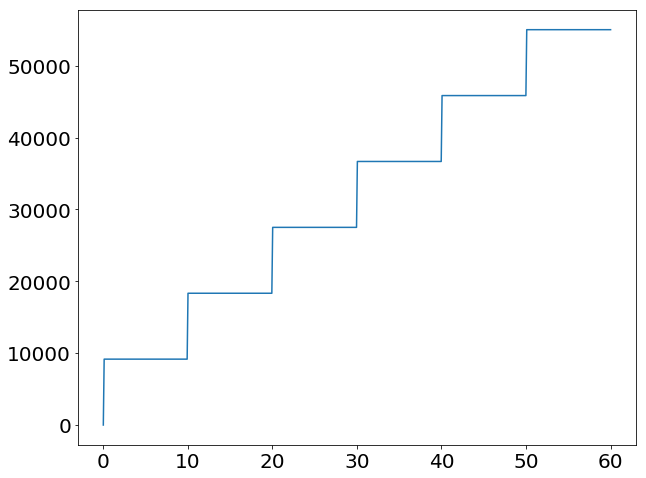

In [25]:
def signal_ramp(t_step, signal_end, step_len):
    num_steps = 60 / step_len
    cut_off = np.ceil(t_step/step_len)
    step = signal_end/num_steps
    return step*cut_off
plt.plot(time,[signal_ramp(x, 55000, 10) for x in time])

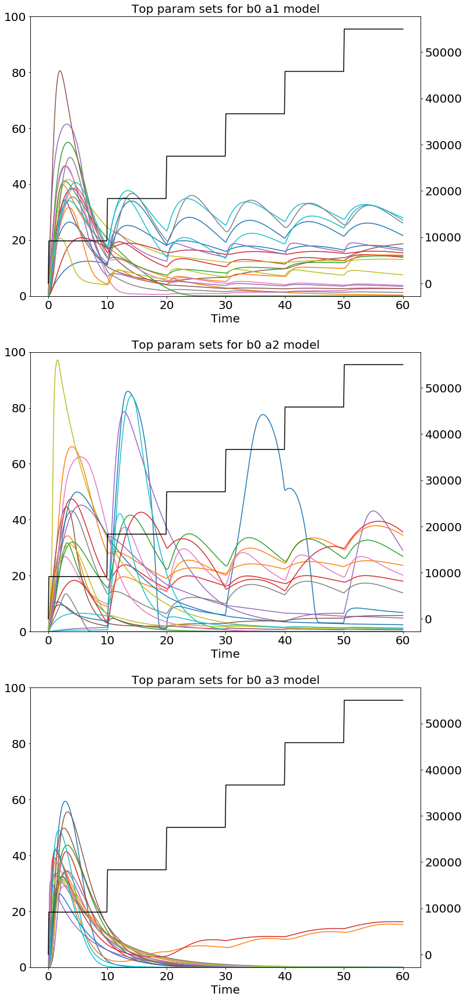

In [31]:
#initialize figure:
plt.clf()
fig, (ax1,ax2,ax3) = plt.subplots(3, 1, figsize=(12,30))
plt.rc('xtick', labelsize=20) 
plt.rc('ytick', labelsize=20)

initals = [MAP3K, MAP2K, MAPK, X, Y]
params_constants = [MAP3K_t, MAP2K_t, MAPK_t, X_t, Y_t]


#plot 1
title_text = 'Top param sets for b0 a1 model'
ax1.set_title(title_text, fontsize=20)
ax1.set_xlabel('Time', fontsize=20)

for idx, param_set in enumerate(top_params_a1[:t]):
    data = odeint(b0_a1_2D_Y_fancy, initals, time, args=(params_constants, param_set,signal_ramp,[_, 550000, 10]))
    ax1.plot(time,data[:,2]/params_constants[2]*100,label=str(idx))
    
ax1.set_ylim(0,100)
ax1b = ax1.twinx()
ax1b.plot(time,[signal_ramp(x, 55000, 10) for x in time], color='black')
# for x in range(0,60,20):
#     ax1.fill_between([x,x+10], 0, 550, facecolor='gray', alpha=0.5)
# ax1.legend()
    
    
#plot2
title_text = 'Top param sets for b0 a2 model'
ax2.set_title(title_text, fontsize=20)
ax2.set_xlabel('Time', fontsize=20)

for idx, param_set in enumerate(top_params_a2[:t]):
    data = odeint(b0_a2_2D_Y_fancy, initals, time, args=(params_constants, param_set,signal_ramp,[_, 550000, 10]))
    ax2.plot(time,data[:,2]/params_constants[2]*100,label=str(idx))
    
ax2.set_ylim(0,100)

ax2b = ax2.twinx()
ax2b.plot(time,[signal_ramp(x, 55000, 10) for x in time], color='black')
# for x in range(0,60,20):
#     ax2.fill_between([x,x+10], 0, 550, facecolor='gray', alpha=0.5)
# ax2.legend()


#plot 3
title_text = 'Top param sets for b0 a3 model'
ax3.set_title(title_text, fontsize=20)
ax3.set_xlabel('Time', fontsize=20)

initals = [MAP3K, MAP2K, MAPK, X, Y]
params_constants = [MAP3K_t, MAP2K_t, MAPK_t, X_t, Y_t]

for idx, param_set in enumerate(top_params_a3[:t]):
    data = odeint(b0_a3_2D_Y_fancy, initals, time, args=(params_constants, param_set,signal_ramp,[_, 550000, 10]))
    ax3.plot(time,data[:,2]/params_constants[2]*100,label=str(idx))
    
ax3.set_ylim(0,100)

ax3b = ax3.twinx()
ax3b.plot(time,[signal_ramp(x, 55000, 10) for x in time], color='black')

# for x in range(0,60,20):
#     ax3.fill_between([x,x+10], 0, 550, facecolor='gray', alpha=0.5)
# ax3.legend()
plt.show()

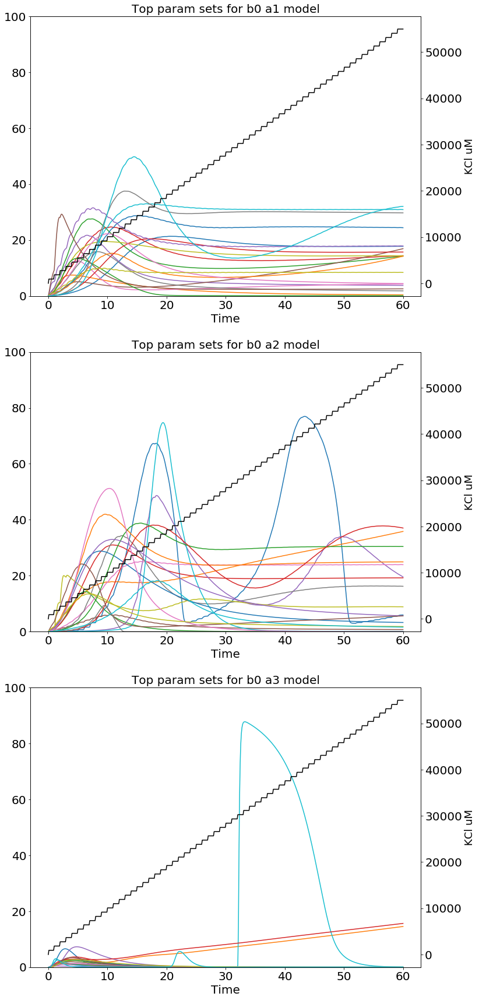

In [32]:
#initialize figure:
plt.clf()
fig, (ax1,ax2,ax3) = plt.subplots(3, 1, figsize=(12,30))
plt.rc('xtick', labelsize=20) 
plt.rc('ytick', labelsize=20)

initals = [MAP3K, MAP2K, MAPK, X, Y]
params_constants = [MAP3K_t, MAP2K_t, MAPK_t, X_t, Y_t]


#plot 1
title_text = 'Top param sets for b0 a1 model'
ax1.set_title(title_text, fontsize=20)
ax1.set_xlabel('Time', fontsize=20)

for idx, param_set in enumerate(top_params_a1[:t]):
    data = odeint(b0_a1_2D_Y_fancy, initals, time, args=(params_constants, param_set,signal_ramp,[_, 550000, 1]))
    ax1.plot(time,data[:,2]/params_constants[2]*100,label=str(idx))
    
ax1.set_ylim(0,100)
ax1b = ax1.twinx()
ax1b.plot(time,[signal_ramp(x, 55000, 1) for x in time], color='black')
ax1b.set_ylabel('KCl uM')
# for x in range(0,60,20):
#     ax1.fill_between([x,x+10], 0, 550, facecolor='gray', alpha=0.5)
# ax1.legend()
    
    
#plot2
title_text = 'Top param sets for b0 a2 model'
ax2.set_title(title_text, fontsize=20)
ax2.set_xlabel('Time', fontsize=20)

for idx, param_set in enumerate(top_params_a2[:t]):
    data = odeint(b0_a2_2D_Y_fancy, initals, time, args=(params_constants, param_set,signal_ramp,[_, 550000, 1]))
    ax2.plot(time,data[:,2]/params_constants[2]*100,label=str(idx))
    
ax2.set_ylim(0,100)

ax2b = ax2.twinx()
ax2b.plot(time,[signal_ramp(x, 55000, 1) for x in time], color='black')
ax2b.set_ylabel('KCl uM')
# for x in range(0,60,20):
#     ax2.fill_between([x,x+10], 0, 550, facecolor='gray', alpha=0.5)
# ax2.legend()


#plot 3
title_text = 'Top param sets for b0 a3 model'
ax3.set_title(title_text, fontsize=20)
ax3.set_xlabel('Time', fontsize=20)

initals = [MAP3K, MAP2K, MAPK, X, Y]
params_constants = [MAP3K_t, MAP2K_t, MAPK_t, X_t, Y_t]

for idx, param_set in enumerate(top_params_a3[:t]):
    data = odeint(b0_a3_2D_Y_fancy, initals, time, args=(params_constants, param_set,signal_ramp,[_, 550000, 1]))
    ax3.plot(time,data[:,2]/params_constants[2]*100,label=str(idx))
    
ax3.set_ylim(0,100)

ax3b = ax3.twinx()
ax3b.plot(time,[signal_ramp(x, 55000, 1) for x in time], color='black')
ax3b.set_ylabel('KCl uM')

# for x in range(0,60,20):
#     ax3.fill_between([x,x+10], 0, 550, facecolor='gray', alpha=0.5)
# ax3.legend()
plt.show()

# Clustering

In [9]:
import scipy.cluster.hierarchy as hac
from scipy.spatial.distance import pdist

In [22]:
df_params_raw = pd.DataFrame(top_params)
df_params = pd.DataFrame(top_params).apply(np.log10)
df_params.head()

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17
0,-3.892630,-0.300456,-3.139591,1.401555,2.750071,1.057557,1.692252,0.967971,3.353323,-0.129763,1.976483,-1.496104,2.632087,3.946914,2.139690,0.877577,2.590735,2.419833
1,-3.271296,-1.032919,-2.737937,1.959020,2.731996,-1.471031,1.977536,1.878976,2.493906,-1.812946,0.400717,2.434236,0.493169,0.971738,-0.389233,2.783184,2.087830,-3.999263
2,-3.458159,0.311196,-2.638597,0.046055,3.795354,-0.320889,0.813572,1.346807,3.921956,2.017096,-3.984441,2.443983,0.188076,1.337684,0.637444,1.963426,2.169619,3.701340
3,-2.528873,-1.916779,-3.629274,2.493673,1.305703,-0.959725,2.112952,2.037336,3.821796,-3.998273,-0.123758,1.618724,1.063368,-3.996487,2.946211,1.359617,3.056356,3.871450
4,-3.063163,1.449168,-1.214736,3.993041,3.098501,-0.213282,3.620455,-0.103360,2.869682,-2.440615,0.353395,1.244205,-0.212543,1.045283,-3.213204,0.391766,2.886603,1.626236


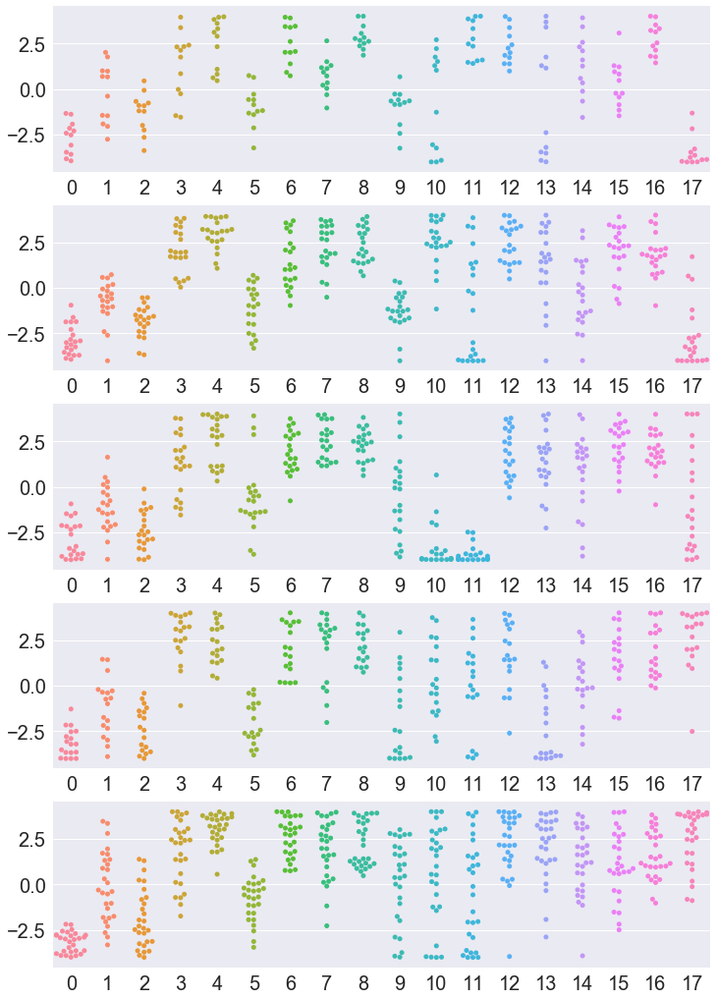

In [26]:
clust_num = 5

pairwise = pdist(df_params, metric='euclidean')
Z = hac.linkage(df_params, method='ward')
cluster = hac.fcluster(Z,t=clust_num,criterion='maxclust')
c, coph_dists = hac.cophenet(Z,pairwise)

sns.set(font_scale = 2)
plt.rcParams['figure.figsize'] = [12.0, 18.0]
fig, axs = plt.subplots(clust_num,1)
# plt.plot(data=df_params.loc[cluster==1,:].values, time = tps, err_style="unit_traces",ax=axs[0])

for i in range(clust_num):
    sns.swarmplot(data = df_params.loc[cluster==i+1,:].values,ax=axs[i])

C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\integrate\odepack.py:218: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)


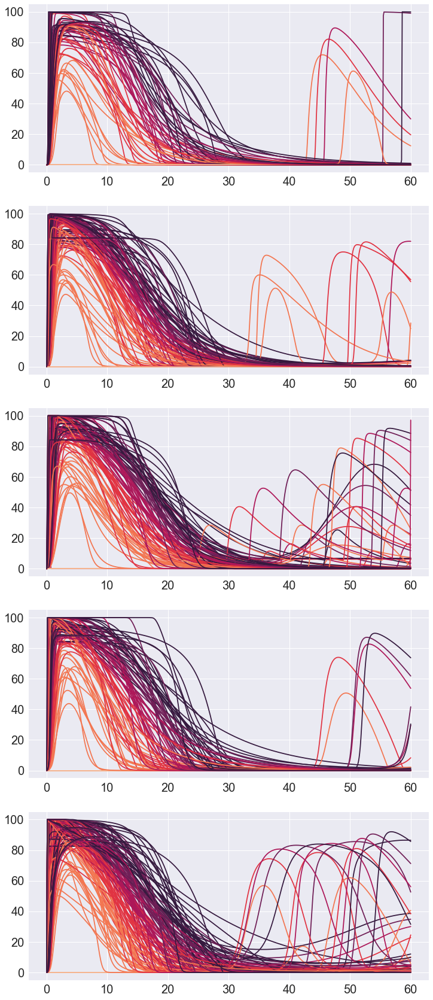

In [27]:
fig, axs = plt.subplots(clust_num, 1, figsize=(12,30))
# plt.plot(data=df_params.loc[cluster==1,:].values, time = tps, err_style="unit_traces",ax=axs[0])

for i in range(clust_num):
    for params in df_params_raw.loc[cluster==i+1,:].values:
        for idx, signal in enumerate(s):
            data = odeint(b0_a3_1D, initals, time, args=(params_constants[:-1]+[signal], params))
            active = data[:,2]
            axs[i].plot(time, active, label=str(signal)+' WT active', color=color_palette[idx])
#     sns.swarmplot(data = df_params.loc[cluster==i+1,:].values,ax=axs[i])

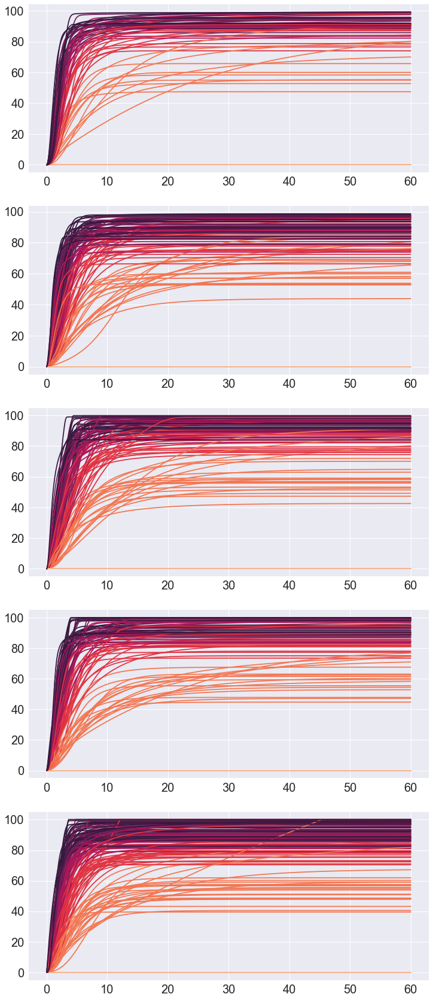

In [28]:
fig, axs = plt.subplots(clust_num, 1, figsize=(12,30))
# plt.plot(data=df_params.loc[cluster==1,:].values, time = tps, err_style="unit_traces",ax=axs[0])

for i in range(clust_num):
    for params in df_params_raw.loc[cluster==i+1,:].values:
        for idx, signal in enumerate(s):
#             data = odeint(b0_a3_1D, initals, time, args=(params_constants[:-1]+[signal], params))
            data = simulate_t100a_experiment_a3_1D(initals, params_constants[:-1]+[signal], params, time)
            active = data[:,2]
            axs[i].plot(time, active, label=str(signal)+' T100A active', color=color_palette[idx])
#     sns.swarmplot(data = df_params.loc[cluster==i+1,:].values,ax=axs[i])